In [1]:
import pandas as pd
from libri_dataframe import build_librispeech_dataframe

LIBRISPEECH_ROOT = "./my_librispeech/LibriSpeech"
#LIBRISPEECH_ROOT = "/mnt/ddn/kyudan/Deepfake-speech/my_raw_audio/LibriSpeech" #for Kyudan
LIBRISPEECH_SUBSET = "test-clean"

dataframe = build_librispeech_dataframe(
    librispeech_root=LIBRISPEECH_ROOT,
    subset=LIBRISPEECH_SUBSET,
)


Loaded 2620 utterances from my_librispeech/LibriSpeech/test-clean
  - Speakers: 40
  - Chapters: 87


In [ ]:
dataframe_1000 = dataframe[:1000]

In [3]:
# 1. 전체 100개 중 고유 화자(Speaker)가 몇 명인지 확인
unique_speakers = dataframe_1000['speaker_id'].unique()
num_unique = len(unique_speakers)

print(f"=== 샘플링 분석 결과 ===")
print(f"총 샘플 개수: {len(dataframe_1000)}개")
print(f"포함된 화자 수: {num_unique}명")
print("-" * 30)

# 2. 화자별로 샘플이 몇 개씩 들어있는지 카운트
speaker_counts = dataframe_1000['speaker_id'].value_counts()

print("화자별 샘플 분포:")
print(speaker_counts)
print("-" * 30)

# 3. 데이터가 화자 ID 순서대로 정렬되어 있었는지 앞부분 확인
print("상위 10개 데이터의 화자 ID 흐름:")
print(dataframe_1000['speaker_id'].head(10).tolist())

=== 샘플링 분석 결과 ===
총 샘플 개수: 100개
포함된 화자 수: 2명
------------------------------
화자별 샘플 분포:
speaker_id
1089    64
1188    36
Name: count, dtype: int64
------------------------------
상위 10개 데이터의 화자 ID 흐름:
[1089, 1089, 1089, 1089, 1089, 1089, 1089, 1089, 1089, 1089]


In [3]:
dataframe_1000

,speaker_id,chapter_id,utterance_id,transcript,audio_path
0,1089,134686,1089-134686-0000,HE HOPED THERE WOULD BE STEW FOR DINNER TURNIP...,my_librispeech/LibriSpeech/test-clean/1089/134...
1,1089,134686,1089-134686-0001,STUFF IT INTO YOU HIS BELLY COUNSELLED HIM,my_librispeech/LibriSpeech/test-clean/1089/134...
2,1089,134686,1089-134686-0002,AFTER EARLY NIGHTFALL THE YELLOW LAMPS WOULD L...,my_librispeech/LibriSpeech/test-clean/1089/134...
3,1089,134686,1089-134686-0003,HELLO BERTIE ANY GOOD IN YOUR MIND,my_librispeech/LibriSpeech/test-clean/1089/134...
4,1089,134686,1089-134686-0004,NUMBER TEN FRESH NELLY IS WAITING ON YOU GOOD ...,my_librispeech/LibriSpeech/test-clean/1089/134...
...,...,...,...,...,...
95,1188,133604,1188-133604-0031,THERE'S ONE AND THERE'S ANOTHER THE DUDLEY AND...,my_librispeech/LibriSpeech/test-clean/1188/133...
96,1188,133604,1188-133604-0032,IT IS ONLY A PENCIL OUTLINE BY EDWARD BURNE JO...,my_librispeech/LibriSpeech/test-clean/1188/133...
97,1188,133604,1188-133604-0033,EVERY PLANT IN THE GRASS IS SET FORMALLY GROWS...,my_librispeech/LibriSpeech/test-clean/1188/133...
98,1188,133604,1188-133604-0034,EXQUISITE ORDER AND UNIVERSAL WITH ETERNAL LIF...,my_librispeech/LibriSpeech/test-clean/1188/133...


# librispeech 6930speaker 목소리로 음성 합성

In [ ]:
import subprocess
import os
import time
import soundfile as sf
from pathlib import Path

# 1. 설정
OUTPUT_DIR = Path("generated_results_F5_Fixed").resolve()
PROMPT_WAV_DIR = Path("prompt_wav_files").resolve()  # prompt를 wav로 변환해서 저장
CUDA_DEVICE = "3" 

os.makedirs(OUTPUT_DIR, exist_ok=True)
os.makedirs(PROMPT_WAV_DIR, exist_ok=True)

def resolve_path(path_str):
    return str(Path(path_str).resolve())

def get_audio_duration(file_path):
    """오디오 파일의 길이를 초 단위로 반환"""
    try:
        with sf.SoundFile(file_path) as f:
            duration = len(f) / f.samplerate
        return duration
    except Exception as e:
        print(f"⚠️ 오디오 길이 측정 실패: {file_path}")
        print(f"   에러: {e}")
        return 0

def convert_to_wav(input_path, output_path):
    """오디오 파일(.flac 등)을 WAV 포맷으로 변환 - soundfile만 사용"""
    try:
        # soundfile로 읽기 (FLAC, WAV 등 지원)
        data, samplerate = sf.read(input_path)
        # WAV로 저장
        sf.write(output_path, data, samplerate)
        return True
    except Exception as e:
        print(f"⚠️ WAV 변환 실패: {input_path}")
        print(f"   에러: {e}")
        return False

def normalize_text(text):
    """텍스트를 F5-TTS에 맞게 정규화"""
    text = text.lower()  # 소문자로 변환
    text = ' '.join(text.split())  # 여러 공백을 하나로
    text = text.strip()
    if not text.endswith(('.', '!', '?', ',')):
        text += '.'  # 마침표 추가
    return text

def save_audio(text, prompt_text, filename, prompt_wav_path=None, seed=None):
    output_path = os.path.join(OUTPUT_DIR, filename)
    
    # 텍스트 정규화
    gen_text = normalize_text(text)
    ref_text = normalize_text(prompt_text)
    
    # 전체 텍스트 출력 (디버깅)
    print(f"  [생성 텍스트] {gen_text}")
    print(f"  [참조 텍스트] {ref_text}")
    
    cmd = [
        "f5-tts_infer-cli",
        "-m", "F5TTS_v1_Base",
        "-r", prompt_wav_path,  # reference audio
        "-s", ref_text,         # reference text
        "-t", gen_text,         # generation text
        "-w", output_path,      # output file
    ]
    
    try:
        start_time = time.time()
        env = os.environ.copy()
        env["CUDA_VISIBLE_DEVICES"] = CUDA_DEVICE if CUDA_DEVICE else ""
        
        result = subprocess.run(cmd, capture_output=True, text=True, check=False, env=env)
        elapsed = time.time() - start_time
        
        if result.returncode == 0 and os.path.exists(output_path):
            print(f"  ✅ 저장 완료: {filename} (소요: {elapsed:.1f}초)")
        else:
            print(f"  ❌ CLI 에러: {filename}")
            if result.stderr:
                stderr_lines = result.stderr.strip().split('\n')
                print(f"     Error: {stderr_lines[-1] if stderr_lines else result.stderr[:200]}")

    except Exception as e:
        print(f"  ❌ 예외 발생: {e}")

# 2. 데이터 준비 및 프롬프트 선정
all_records = dataframe[['speaker_id', 'transcript', 'audio_path']].to_dict('records')
speaker_prompt_lookup = {}

print("=== Speaker별 최적 프롬프트 선정 및 WAV 변환 중... ===")
for row in all_records:
    spk_id = row['speaker_id']
    audio_path = resolve_path(row['audio_path'])
    
    if spk_id in speaker_prompt_lookup:
        continue
        
    if not os.path.exists(audio_path):
        continue
        
    # 오디오 길이 체크 (3~10초)
    dur = get_audio_duration(audio_path)
    if 3.0 <= dur <= 10.0:
        # WAV 파일로 변환
        wav_filename = f"prompt_speaker_{spk_id}.wav"
        wav_path = PROMPT_WAV_DIR / wav_filename
        
        # 이미 변환된 파일이 있으면 스킵
        if not wav_path.exists():
            print(f"  Speaker {spk_id}: {dur:.2f}초 - WAV로 변환 중...")
            if not convert_to_wav(audio_path, str(wav_path)):
                continue
        else:
            print(f"  Speaker {spk_id}: {dur:.2f}초 - 이미 WAV 파일 존재")
        
        speaker_prompt_lookup[spk_id] = {
            'prompt_text': row['transcript'],
            'prompt_wav_path': str(wav_path),
            'original_audio_path': audio_path,
            'duration': dur
        }

print(f"\n총 {len(speaker_prompt_lookup)}명의 화자에 대한 유효 프롬프트 선정 완료.\n")

# 프롬프트 확인 (전체 텍스트 출력)
print("=== Prompt Audio-Transcript Verification (샘플 5개) ===")
for speaker_id, prompt_info in list(speaker_prompt_lookup.items())[:5]:
    print(f"\nSpeaker {speaker_id} (Duration: {prompt_info['duration']:.2f}초)")
    print(f"  Original: .../{Path(prompt_info['original_audio_path']).name}")
    print(f"  WAV:      .../{Path(prompt_info['prompt_wav_path']).name}")
    print(f"  Text:     {normalize_text(prompt_info['prompt_text'])}")
print("=" * 60)

# 입력 데이터 구성
input_rows = dataframe_1000[['transcript', 'audio_path', 'speaker_id']].to_dict('records')
input_data = []

for idx, row in enumerate(input_rows):
    spk_id = row['speaker_id']
    
    if spk_id in speaker_prompt_lookup:
        prompt = speaker_prompt_lookup[spk_id]
    else:
        print(f"⚠️ 화자 {spk_id}: 적절한 길이의 프롬프트를 찾지 못함, 현재 파일 사용")
        # 현재 파일도 WAV로 변환
        current_wav_path = PROMPT_WAV_DIR / f"fallback_{idx}_{spk_id}.wav"
        if not current_wav_path.exists():
            convert_to_wav(resolve_path(row['audio_path']), str(current_wav_path))
        
        prompt = {
            'prompt_text': row['transcript'],
            'prompt_wav_path': str(current_wav_path)
        }

    input_data.append({
        "text": row['transcript'],
        "filename": f"gen_{idx:03d}_{spk_id}.wav",
        "prompt_text": prompt['prompt_text'],
        "prompt_wav_path": prompt['prompt_wav_path'],
        "seed": 2024 + idx
    })

# 3. 실행
if __name__ == "__main__":
    print(f"\n{'='*60}")
    print(f"총 {len(input_data)}개의 오디오 생성 시작")
    print(f"{'='*60}\n")
    
    for idx, item in enumerate(input_data, start=1):
        print(f"\n[{idx:02d}/{len(input_data):02d}] 원본 텍스트:")
        print(f"  {item['text']}")
        print(f"  프롬프트 WAV: {Path(item['prompt_wav_path']).name}")
        save_audio(**item)


=== Speaker별 최적 프롬프트 선정 및 WAV 변환 중... ===
  Speaker 1089: 3.27초 - 이미 WAV 파일 존재
  Speaker 1188: 9.04초 - 이미 WAV 파일 존재
  Speaker 121: 8.46초 - 이미 WAV 파일 존재
  Speaker 1221: 4.83초 - 이미 WAV 파일 존재
  Speaker 1284: 8.12초 - 이미 WAV 파일 존재
  Speaker 1320: 9.52초 - 이미 WAV 파일 존재
  Speaker 1580: 8.94초 - 이미 WAV 파일 존재
  Speaker 1995: 9.48초 - 이미 WAV 파일 존재
  Speaker 2094: 8.03초 - 이미 WAV 파일 존재
  Speaker 2300: 5.08초 - 이미 WAV 파일 존재
  Speaker 237: 8.92초 - 이미 WAV 파일 존재
  Speaker 260: 7.04초 - 이미 WAV 파일 존재
  Speaker 2830: 6.12초 - 이미 WAV 파일 존재
  Speaker 2961: 8.25초 - 이미 WAV 파일 존재
  Speaker 3570: 5.67초 - 이미 WAV 파일 존재
  Speaker 3575: 8.23초 - 이미 WAV 파일 존재
  Speaker 3729: 8.78초 - 이미 WAV 파일 존재
  Speaker 4077: 9.56초 - 이미 WAV 파일 존재
  Speaker 4446: 3.50초 - 이미 WAV 파일 존재
  Speaker 4507: 3.19초 - 이미 WAV 파일 존재
  Speaker 4970: 3.03초 - 이미 WAV 파일 존재
  Speaker 4992: 6.64초 - 이미 WAV 파일 존재
  Speaker 5105: 4.51초 - 이미 WAV 파일 존재
  Speaker 5142: 5.02초 - 이미 WAV 파일 존재
  Speaker 5639: 8.91초 - 이미 WAV 파일 존재
  Speaker 5683: 3.51초 - 이미 WAV 파일 존재

In [ ]:
import matplotlib.pyplot as plt
import torchaudio
import torch
import numpy as np
from pathlib import Path

# (기존과 동일)
def compute_mel_spectrogram(audio_path, n_mels=80):
    try:
        waveform, sr = torchaudio.load(audio_path)
        mel = torchaudio.transforms.MelSpectrogram(
            sample_rate=sr, n_fft=1024, hop_length=256, n_mels=n_mels, normalized=True
        )(waveform)
        mel_db = torchaudio.functional.amplitude_to_DB(mel, multiplier=10.0, amin=1e-10, db_multiplier=1.0)
        return mel_db.squeeze(0)
    except Exception as e:
        print(f"Error loading {audio_path}: {e}")
        return None

# (기존과 동일)
def compute_gradient_field(mel_tensor):
    mel_np = mel_tensor.numpy()
    grad_y, grad_x = np.gradient(mel_np)
    gradient_magnitude = np.sqrt(grad_x**2 + grad_y**2)
    grad_variance = np.var(gradient_magnitude)
    grad_mean = np.mean(gradient_magnitude)
    return gradient_magnitude, grad_variance, grad_mean

# (기존과 동일)
def plot_analysis(ax_spec, ax_grad, mel_tensor, title, grad_stats):
    ax_spec.imshow(mel_tensor.numpy(), origin='lower', aspect='auto', cmap='inferno')
    ax_spec.set_title(f"{title}\n(Log-Mel)", fontsize=10)
    ax_spec.axis('off')
    
    grad_mag, var, mean = compute_gradient_field(mel_tensor)
    ax_grad.imshow(grad_mag, origin='lower', aspect='auto', cmap='gray')
    
    stat_text = f"Grad Var: {var:.2f}\nGrad Mean: {mean:.2f}"
    ax_grad.text(0.02, 0.95, stat_text, transform=ax_grad.transAxes, color='cyan', 
                 fontsize=9, verticalalignment='top', fontweight='bold')
    ax_grad.set_title("Gradient Field", fontsize=10)
    ax_grad.axis('off')
    return grad_stats

# --- 수정된 부분: index와 speaker_id를 사용하여 올바른 파일 경로 생성 ---
def visualize_triplet_analysis(row, idx):
    base_name = Path(row['audio_path']).stem
    speaker_id = row['speaker_id']
    
    # Gen 1 (Likely TTS)을 리스트에서 삭제했습니다.
    targets = [
        (Path(row['audio_path']).resolve(), "Original (Real)"),
        (Path(f"generated_results_F5_Fixed/gen_{idx:03d}_{speaker_id}.wav"), "Gen 2 (Voice Conversion)"),
    ]

    # 열(column) 개수가 2개이므로 figsize를 가로로 조금 줄였습니다 (15 -> 10)
    fig, axes = plt.subplots(2, len(targets), figsize=(10, 3))
    
    stats_list = []

    for idx, (audio_path, label) in enumerate(targets):
        # axes가 2차원 배열이므로 [행, 열] 인덱싱
        ax_spec = axes[0, idx] 
        ax_grad = axes[1, idx] 
        
        if not audio_path.exists():
            ax_spec.text(0.5, 0.5, "File Not Found", ha='center')
            ax_spec.axis('off')
            ax_grad.axis('off')
            stats_list.append(None)
            continue
            
        mel = compute_mel_spectrogram(str(audio_path))
        
        if mel is not None:
            _, var, mean = compute_gradient_field(mel)
            plot_analysis(ax_spec, ax_grad, mel, label, (var, mean))
            stats_list.append({'label': label, 'var': var, 'mean': mean})
        else:
            ax_spec.text(0.5, 0.5, "Load Error", ha='center')
            ax_spec.axis('off')
            ax_grad.axis('off')
            stats_list.append(None)

    fig.suptitle(f"Gradient Analysis: {base_name}", fontsize=14, fontweight='bold')
    plt.tight_layout()
    plt.show()
    
    # 텍스트 리포트
    print(f"--- Analysis Report for {base_name} ---")
    if stats_list and stats_list[0] is not None:
        real_var = stats_list[0]['var']
        print(f"Real Audio Gradient Variance: {real_var:.4f}")
        
        for stat in stats_list[1:]:
            if stat:
                diff = stat['var'] - real_var
                print(f"[{stat['label']}] Diff from Real: {diff:.4f}")
    print("-" * 50)

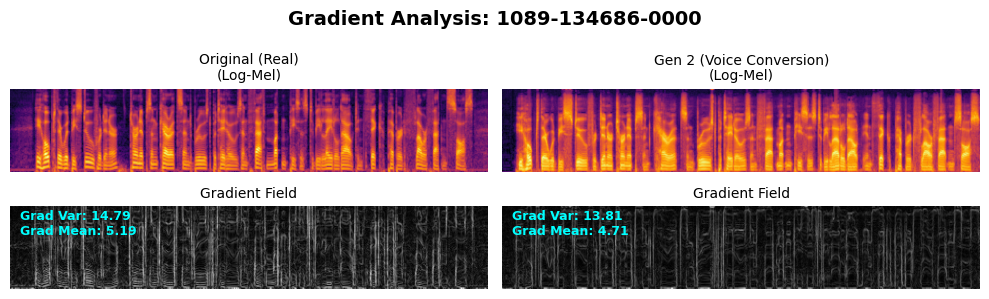

--- Analysis Report for 1089-134686-0000 ---
Real Audio Gradient Variance: 14.7907
[Gen 2 (Voice Conversion)] Diff from Real: -0.9834
--------------------------------------------------


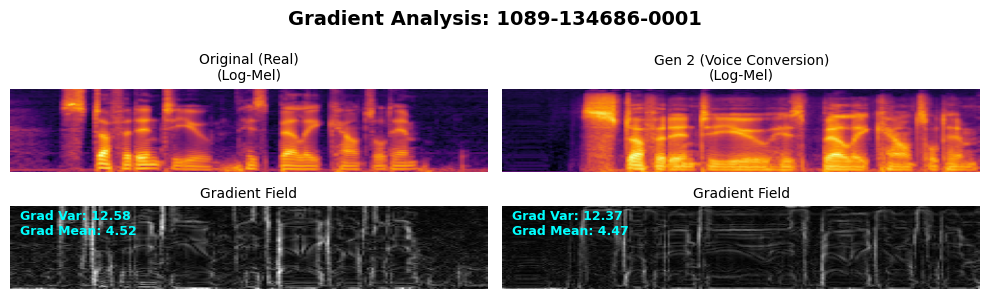

--- Analysis Report for 1089-134686-0001 ---
Real Audio Gradient Variance: 12.5803
[Gen 2 (Voice Conversion)] Diff from Real: -0.2081
--------------------------------------------------


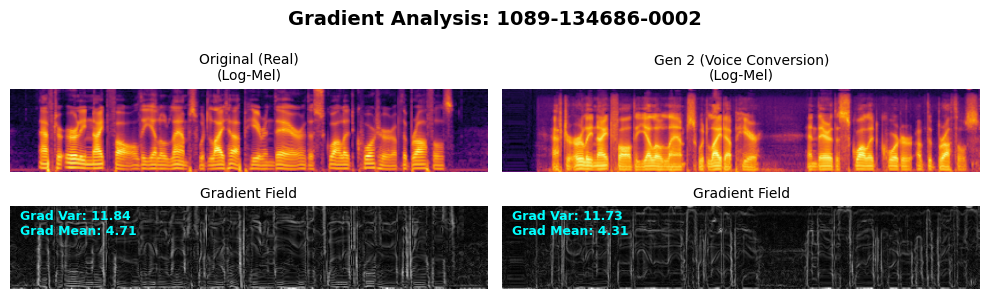

--- Analysis Report for 1089-134686-0002 ---
Real Audio Gradient Variance: 11.8414
[Gen 2 (Voice Conversion)] Diff from Real: -0.1124
--------------------------------------------------


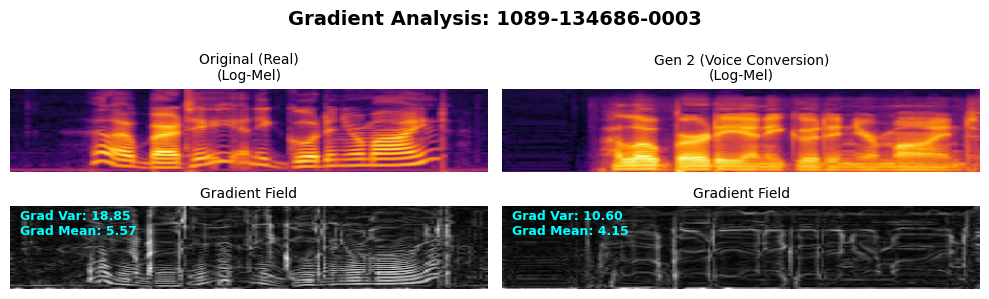

--- Analysis Report for 1089-134686-0003 ---
Real Audio Gradient Variance: 18.8482
[Gen 2 (Voice Conversion)] Diff from Real: -8.2488
--------------------------------------------------


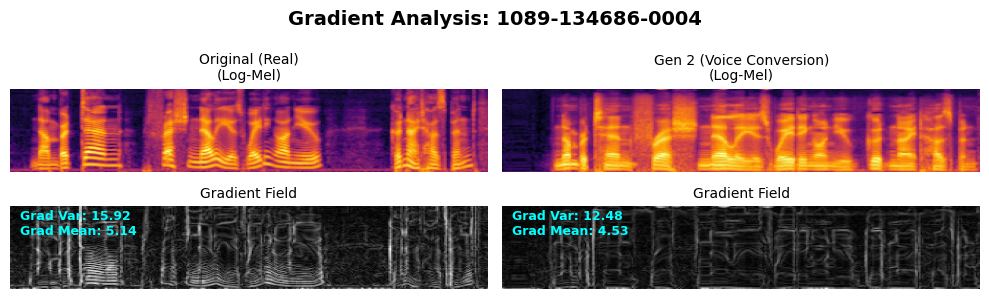

--- Analysis Report for 1089-134686-0004 ---
Real Audio Gradient Variance: 15.9219
[Gen 2 (Voice Conversion)] Diff from Real: -3.4412
--------------------------------------------------


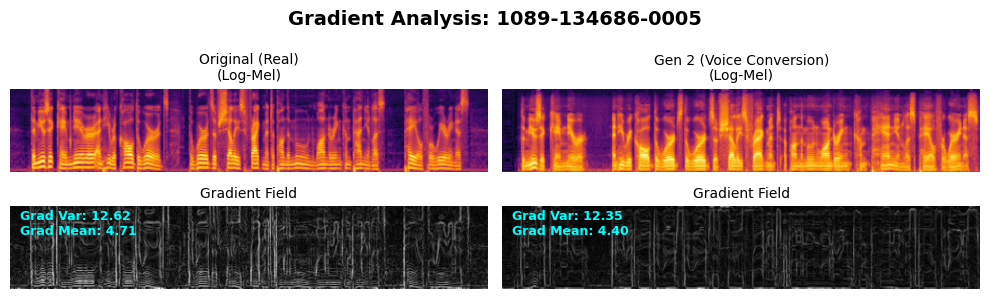

--- Analysis Report for 1089-134686-0005 ---
Real Audio Gradient Variance: 12.6217
[Gen 2 (Voice Conversion)] Diff from Real: -0.2715
--------------------------------------------------


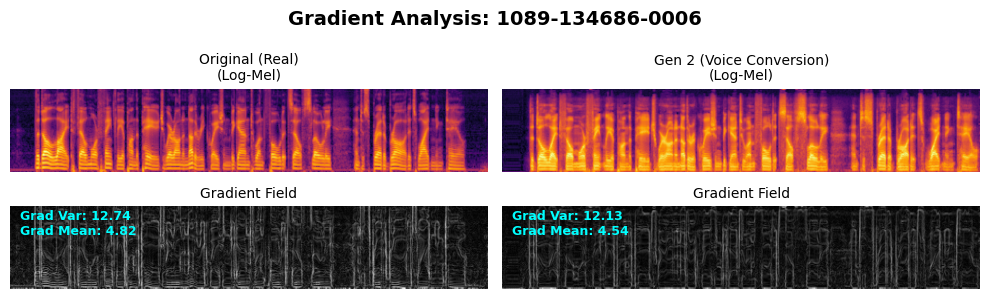

--- Analysis Report for 1089-134686-0006 ---
Real Audio Gradient Variance: 12.7444
[Gen 2 (Voice Conversion)] Diff from Real: -0.6107
--------------------------------------------------


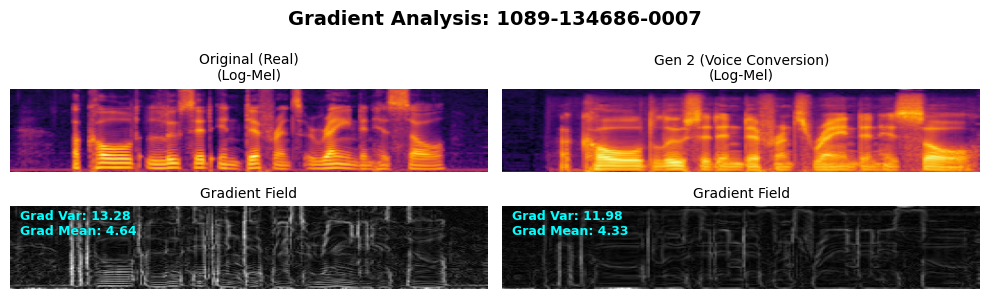

--- Analysis Report for 1089-134686-0007 ---
Real Audio Gradient Variance: 13.2849
[Gen 2 (Voice Conversion)] Diff from Real: -1.3011
--------------------------------------------------


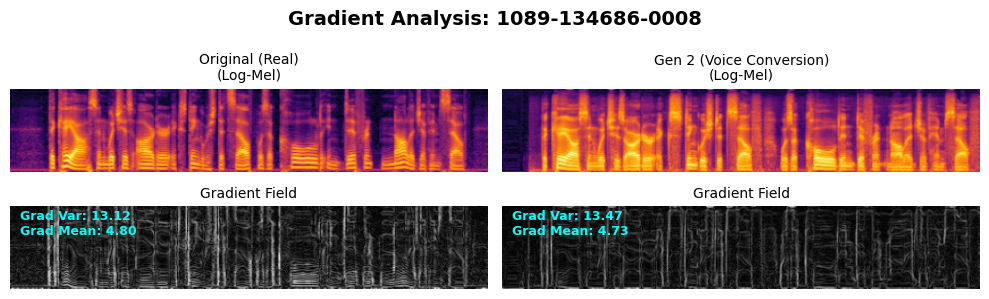

--- Analysis Report for 1089-134686-0008 ---
Real Audio Gradient Variance: 13.1154
[Gen 2 (Voice Conversion)] Diff from Real: 0.3587
--------------------------------------------------


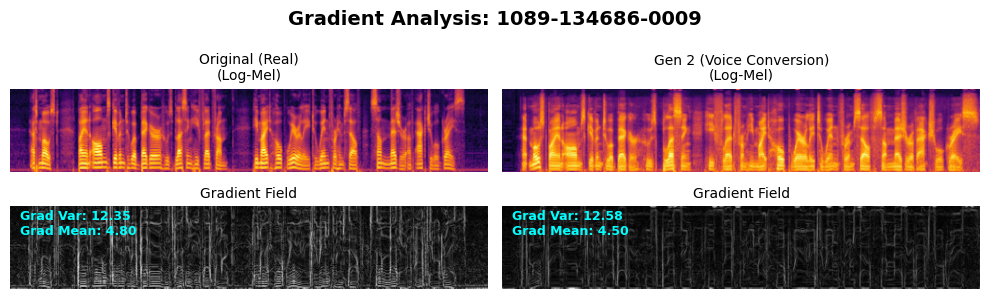

--- Analysis Report for 1089-134686-0009 ---
Real Audio Gradient Variance: 12.3545
[Gen 2 (Voice Conversion)] Diff from Real: 0.2285
--------------------------------------------------


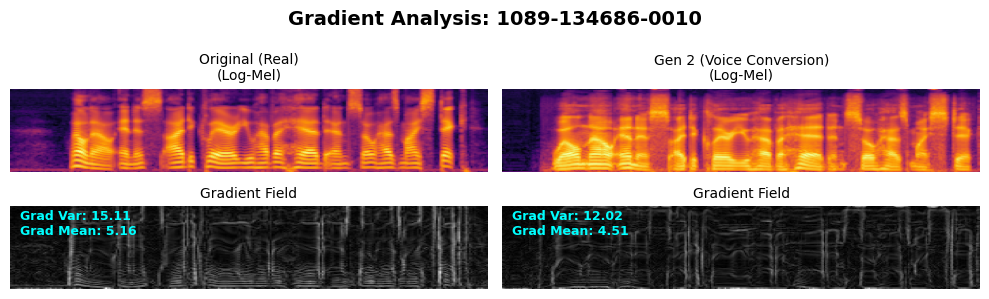

--- Analysis Report for 1089-134686-0010 ---
Real Audio Gradient Variance: 15.1124
[Gen 2 (Voice Conversion)] Diff from Real: -3.0966
--------------------------------------------------


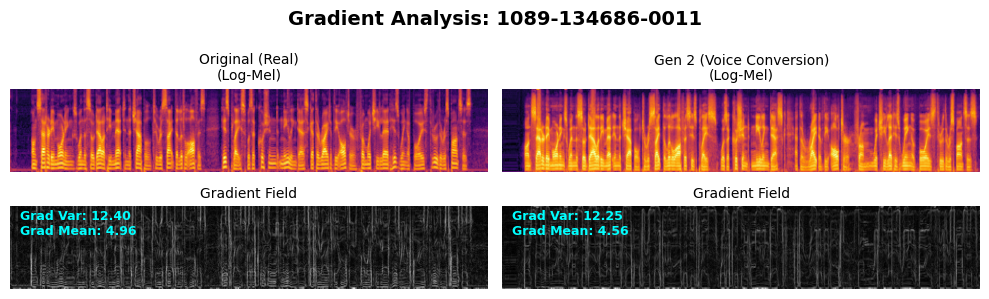

--- Analysis Report for 1089-134686-0011 ---
Real Audio Gradient Variance: 12.3995
[Gen 2 (Voice Conversion)] Diff from Real: -0.1503
--------------------------------------------------


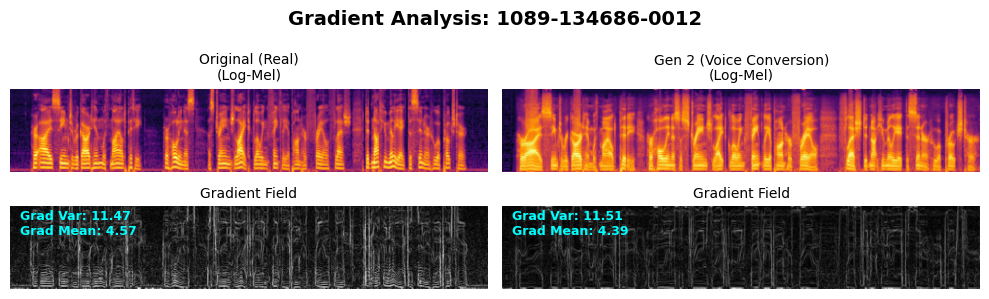

--- Analysis Report for 1089-134686-0012 ---
Real Audio Gradient Variance: 11.4735
[Gen 2 (Voice Conversion)] Diff from Real: 0.0318
--------------------------------------------------


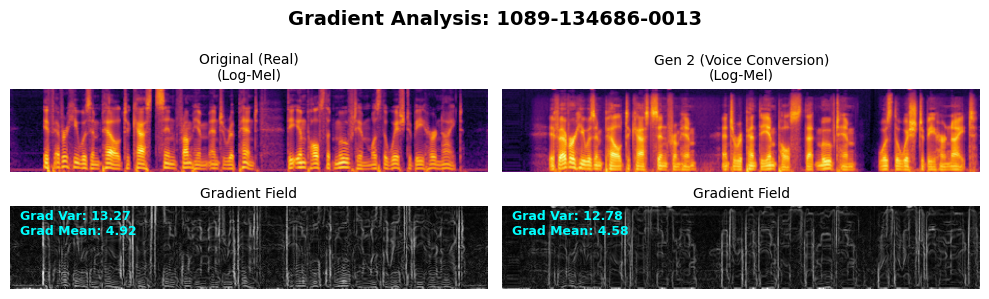

--- Analysis Report for 1089-134686-0013 ---
Real Audio Gradient Variance: 13.2651
[Gen 2 (Voice Conversion)] Diff from Real: -0.4895
--------------------------------------------------


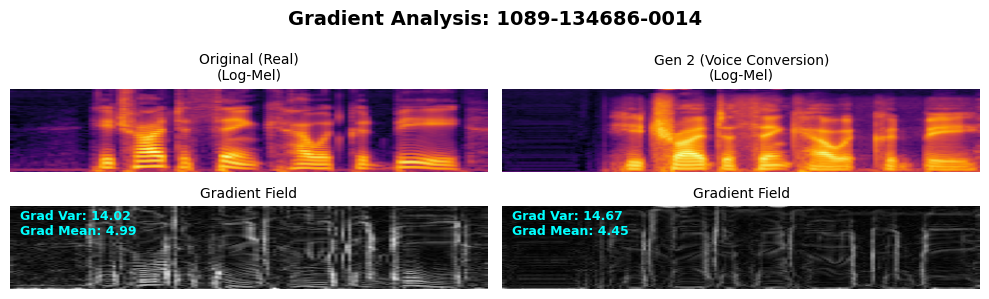

--- Analysis Report for 1089-134686-0014 ---
Real Audio Gradient Variance: 14.0187
[Gen 2 (Voice Conversion)] Diff from Real: 0.6470
--------------------------------------------------


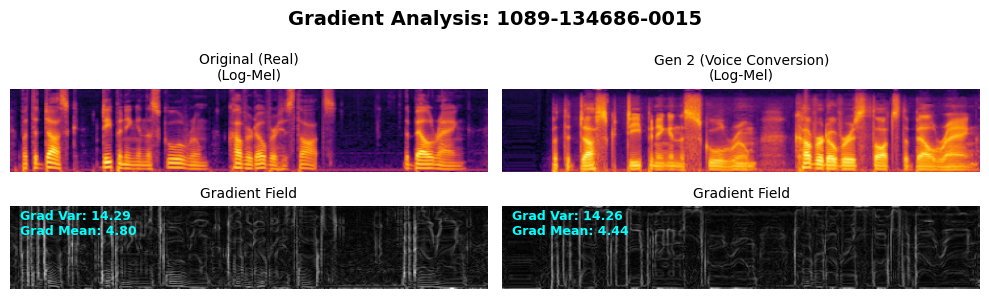

--- Analysis Report for 1089-134686-0015 ---
Real Audio Gradient Variance: 14.2907
[Gen 2 (Voice Conversion)] Diff from Real: -0.0304
--------------------------------------------------


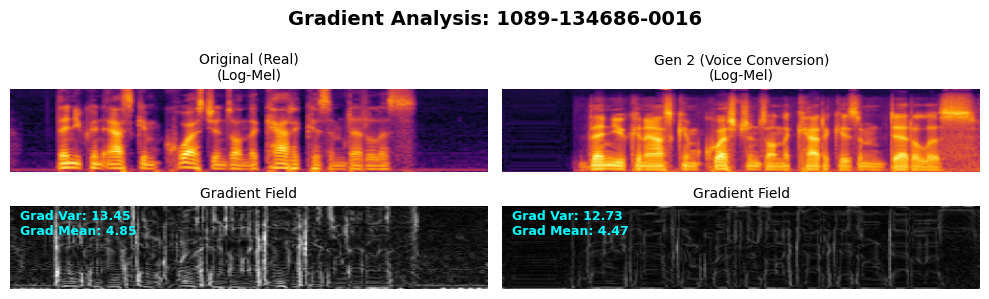

--- Analysis Report for 1089-134686-0016 ---
Real Audio Gradient Variance: 13.4541
[Gen 2 (Voice Conversion)] Diff from Real: -0.7284
--------------------------------------------------


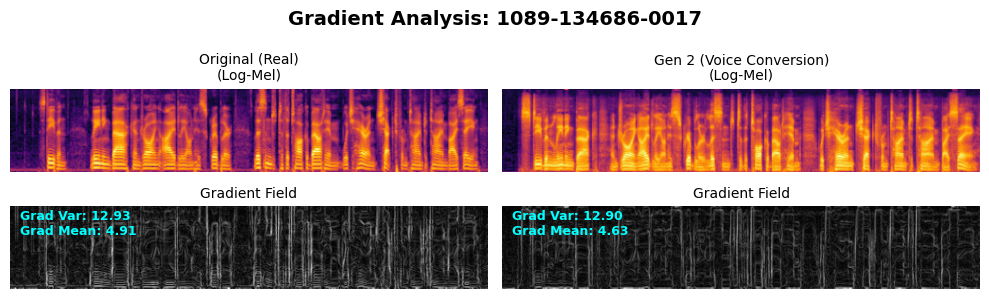

--- Analysis Report for 1089-134686-0017 ---
Real Audio Gradient Variance: 12.9345
[Gen 2 (Voice Conversion)] Diff from Real: -0.0385
--------------------------------------------------


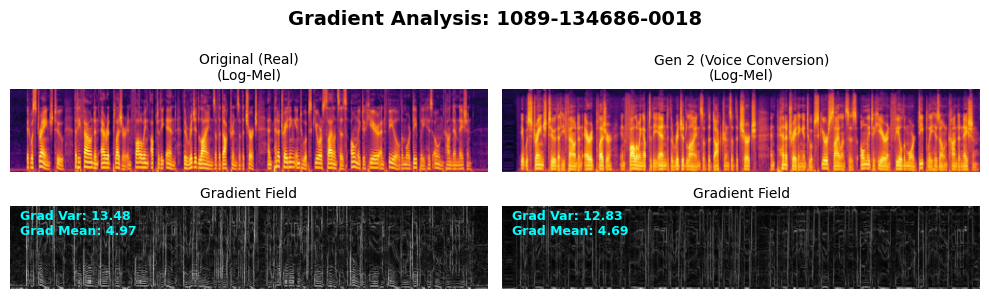

--- Analysis Report for 1089-134686-0018 ---
Real Audio Gradient Variance: 13.4756
[Gen 2 (Voice Conversion)] Diff from Real: -0.6443
--------------------------------------------------


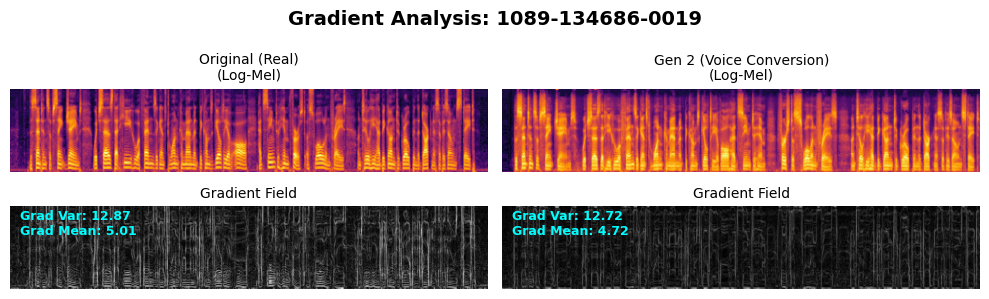

--- Analysis Report for 1089-134686-0019 ---
Real Audio Gradient Variance: 12.8695
[Gen 2 (Voice Conversion)] Diff from Real: -0.1456
--------------------------------------------------


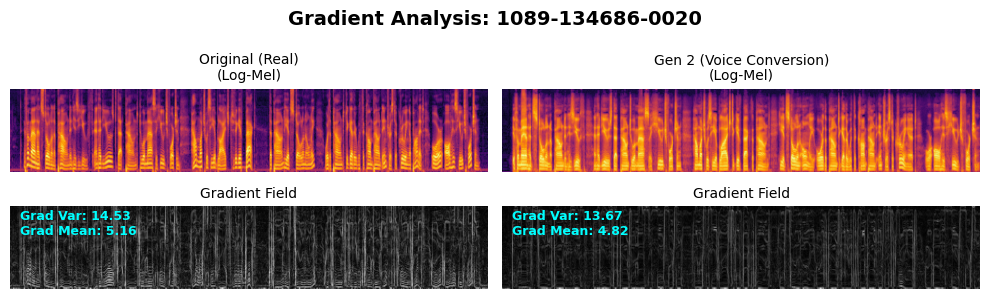

--- Analysis Report for 1089-134686-0020 ---
Real Audio Gradient Variance: 14.5281
[Gen 2 (Voice Conversion)] Diff from Real: -0.8600
--------------------------------------------------


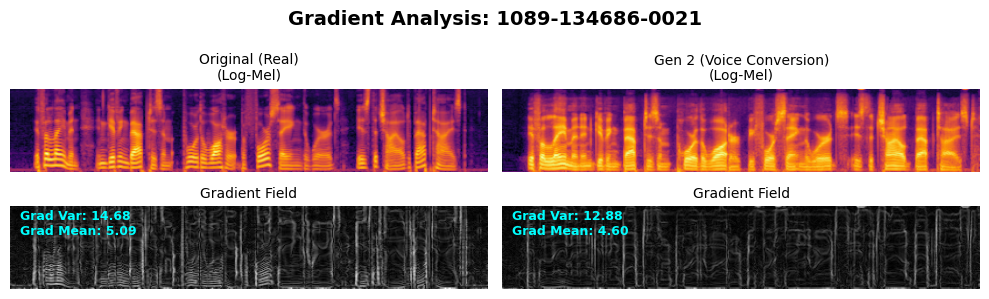

--- Analysis Report for 1089-134686-0021 ---
Real Audio Gradient Variance: 14.6791
[Gen 2 (Voice Conversion)] Diff from Real: -1.7953
--------------------------------------------------


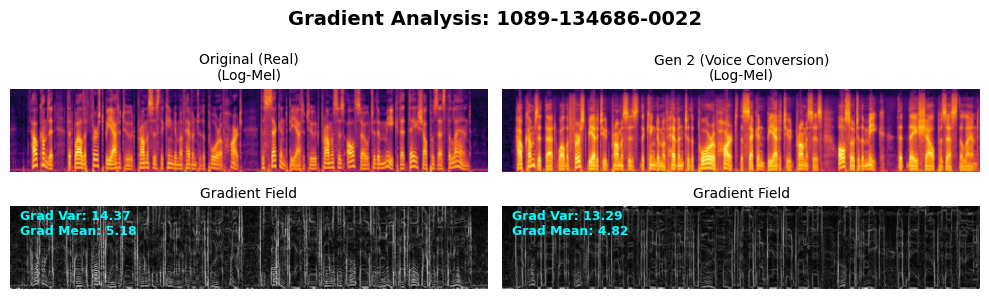

--- Analysis Report for 1089-134686-0022 ---
Real Audio Gradient Variance: 14.3711
[Gen 2 (Voice Conversion)] Diff from Real: -1.0831
--------------------------------------------------


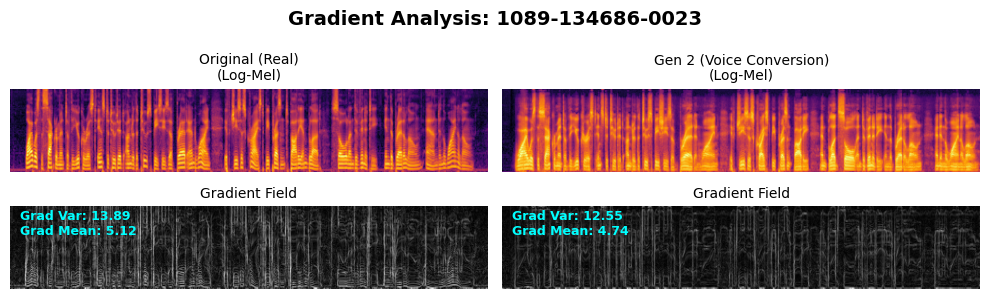

--- Analysis Report for 1089-134686-0023 ---
Real Audio Gradient Variance: 13.8939
[Gen 2 (Voice Conversion)] Diff from Real: -1.3410
--------------------------------------------------


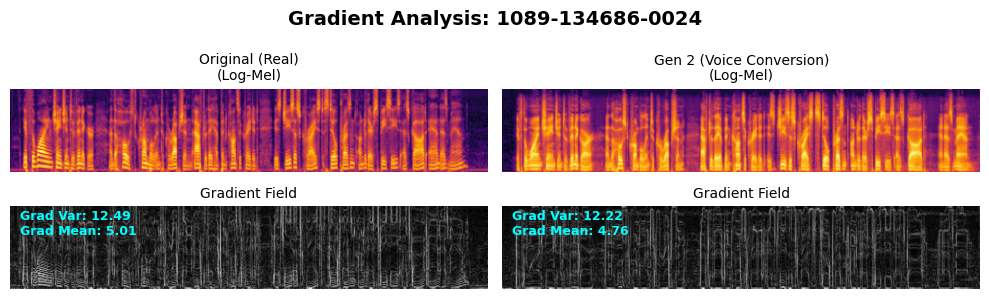

--- Analysis Report for 1089-134686-0024 ---
Real Audio Gradient Variance: 12.4945
[Gen 2 (Voice Conversion)] Diff from Real: -0.2716
--------------------------------------------------


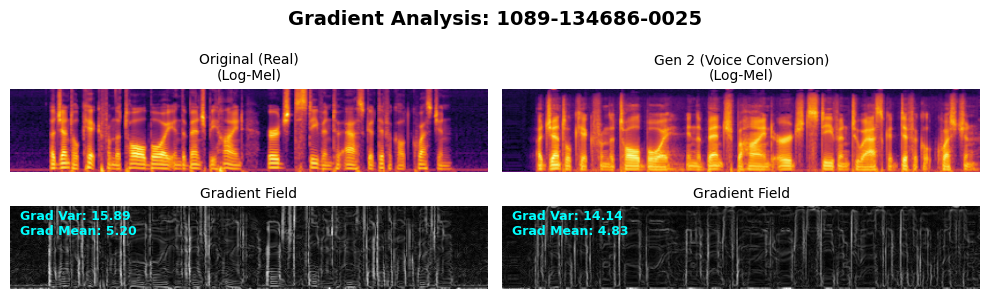

--- Analysis Report for 1089-134686-0025 ---
Real Audio Gradient Variance: 15.8902
[Gen 2 (Voice Conversion)] Diff from Real: -1.7519
--------------------------------------------------


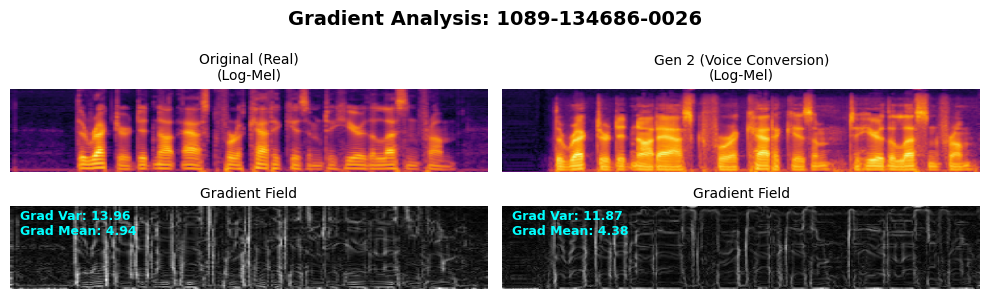

--- Analysis Report for 1089-134686-0026 ---
Real Audio Gradient Variance: 13.9556
[Gen 2 (Voice Conversion)] Diff from Real: -2.0842
--------------------------------------------------


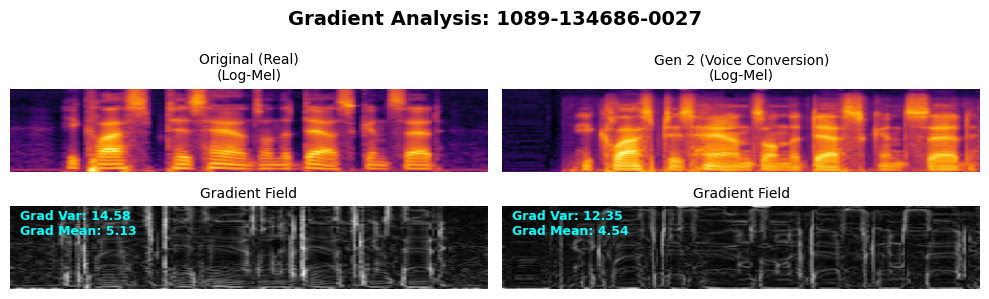

--- Analysis Report for 1089-134686-0027 ---
Real Audio Gradient Variance: 14.5788
[Gen 2 (Voice Conversion)] Diff from Real: -2.2301
--------------------------------------------------


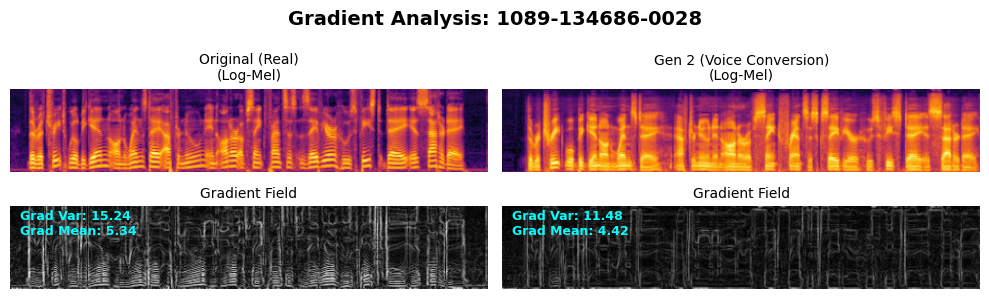

--- Analysis Report for 1089-134686-0028 ---
Real Audio Gradient Variance: 15.2444
[Gen 2 (Voice Conversion)] Diff from Real: -3.7614
--------------------------------------------------


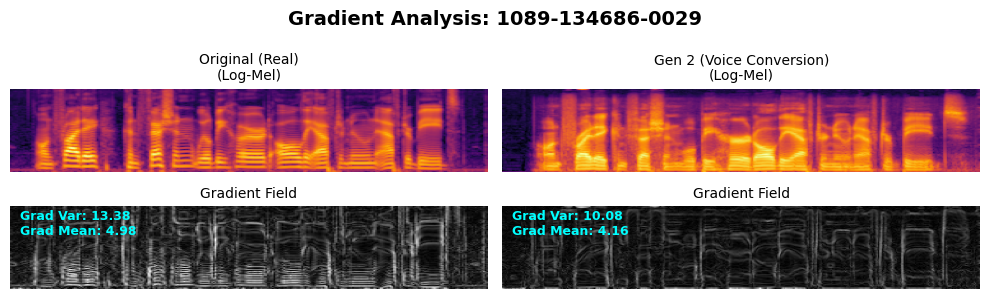

--- Analysis Report for 1089-134686-0029 ---
Real Audio Gradient Variance: 13.3813
[Gen 2 (Voice Conversion)] Diff from Real: -3.2977
--------------------------------------------------


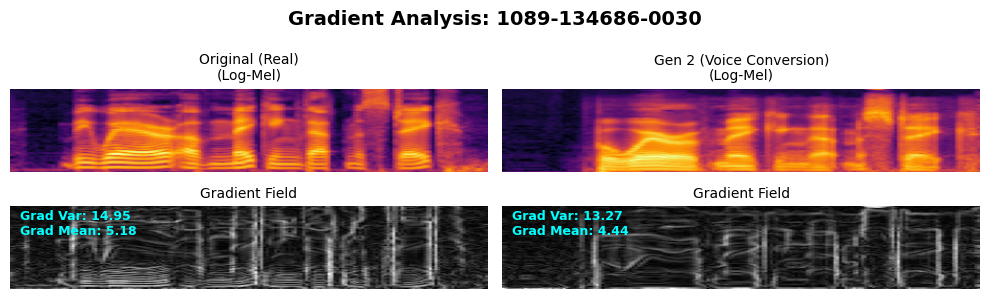

--- Analysis Report for 1089-134686-0030 ---
Real Audio Gradient Variance: 14.9460
[Gen 2 (Voice Conversion)] Diff from Real: -1.6770
--------------------------------------------------


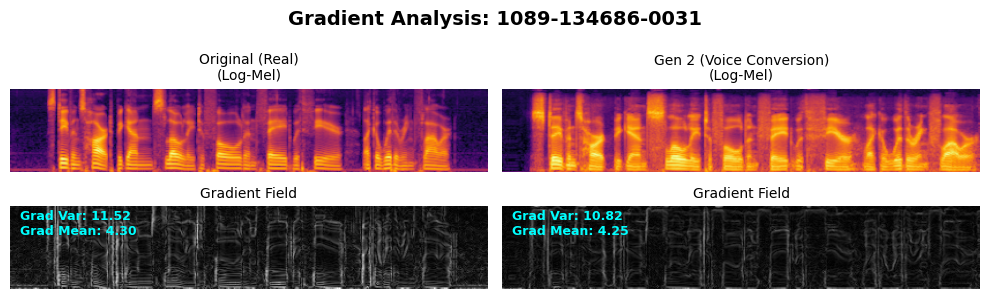

--- Analysis Report for 1089-134686-0031 ---
Real Audio Gradient Variance: 11.5213
[Gen 2 (Voice Conversion)] Diff from Real: -0.7010
--------------------------------------------------


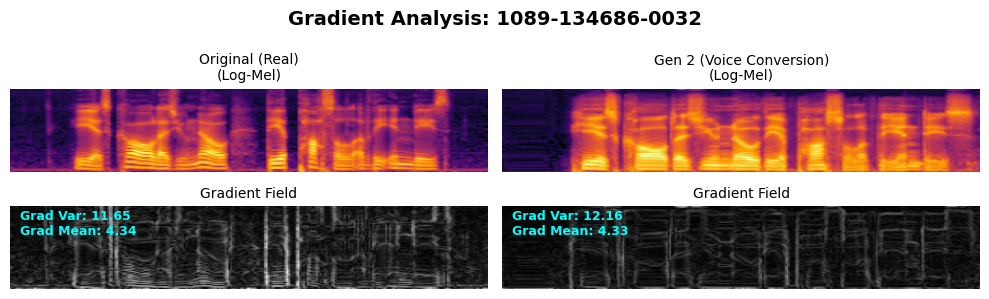

--- Analysis Report for 1089-134686-0032 ---
Real Audio Gradient Variance: 11.6529
[Gen 2 (Voice Conversion)] Diff from Real: 0.5061
--------------------------------------------------


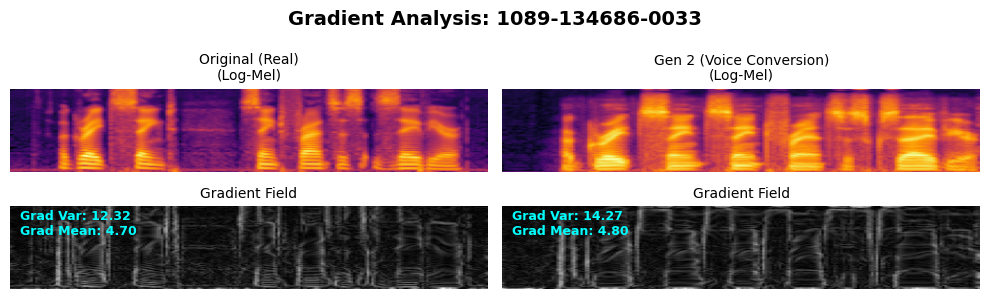

--- Analysis Report for 1089-134686-0033 ---
Real Audio Gradient Variance: 12.3181
[Gen 2 (Voice Conversion)] Diff from Real: 1.9533
--------------------------------------------------


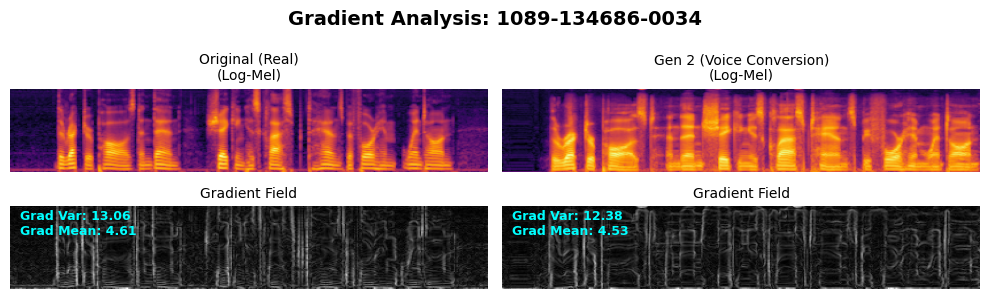

--- Analysis Report for 1089-134686-0034 ---
Real Audio Gradient Variance: 13.0612
[Gen 2 (Voice Conversion)] Diff from Real: -0.6813
--------------------------------------------------


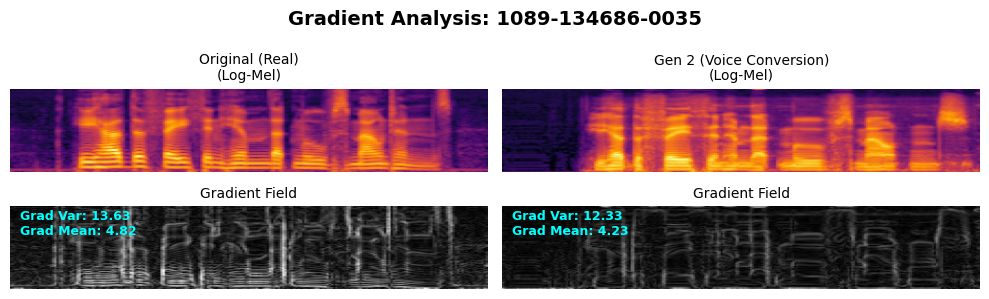

--- Analysis Report for 1089-134686-0035 ---
Real Audio Gradient Variance: 13.6341
[Gen 2 (Voice Conversion)] Diff from Real: -1.3044
--------------------------------------------------


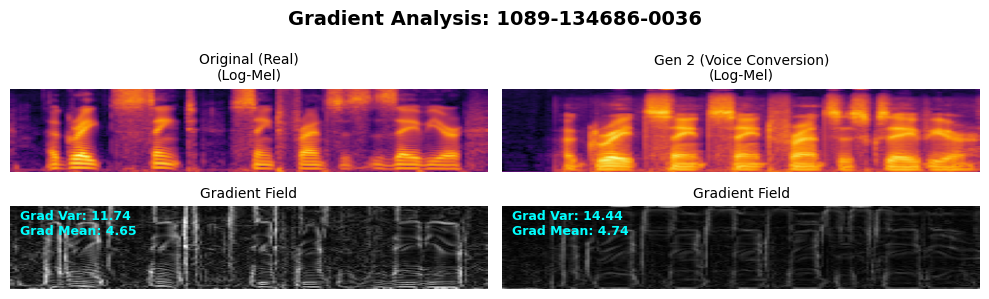

--- Analysis Report for 1089-134686-0036 ---
Real Audio Gradient Variance: 11.7406
[Gen 2 (Voice Conversion)] Diff from Real: 2.7008
--------------------------------------------------


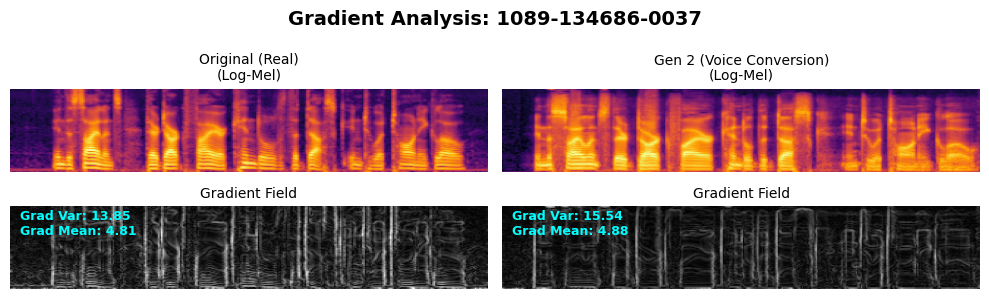

--- Analysis Report for 1089-134686-0037 ---
Real Audio Gradient Variance: 13.8513
[Gen 2 (Voice Conversion)] Diff from Real: 1.6886
--------------------------------------------------


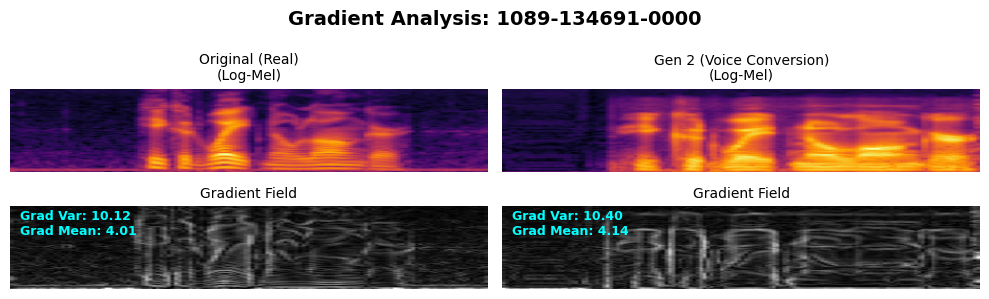

--- Analysis Report for 1089-134691-0000 ---
Real Audio Gradient Variance: 10.1248
[Gen 2 (Voice Conversion)] Diff from Real: 0.2728
--------------------------------------------------


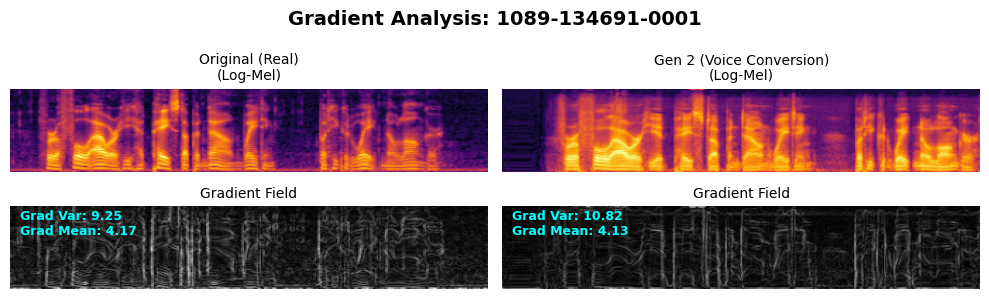

--- Analysis Report for 1089-134691-0001 ---
Real Audio Gradient Variance: 9.2511
[Gen 2 (Voice Conversion)] Diff from Real: 1.5736
--------------------------------------------------


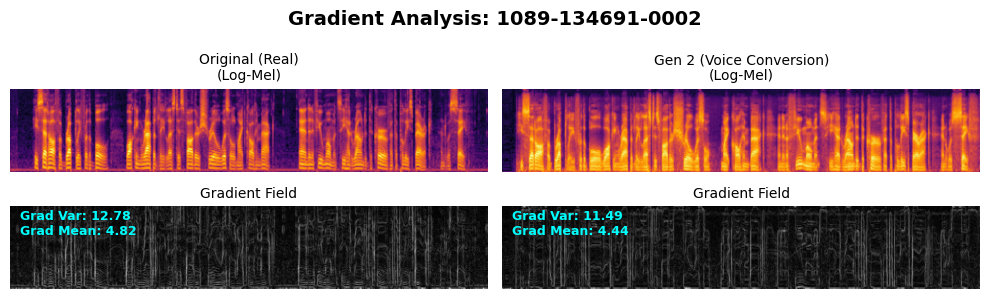

--- Analysis Report for 1089-134691-0002 ---
Real Audio Gradient Variance: 12.7772
[Gen 2 (Voice Conversion)] Diff from Real: -1.2874
--------------------------------------------------


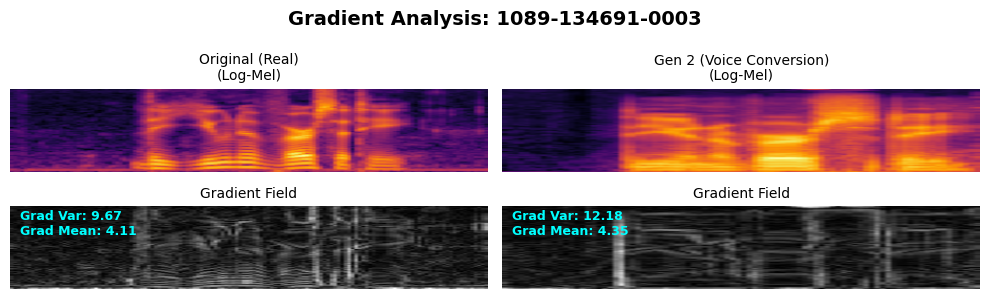

--- Analysis Report for 1089-134691-0003 ---
Real Audio Gradient Variance: 9.6693
[Gen 2 (Voice Conversion)] Diff from Real: 2.5114
--------------------------------------------------


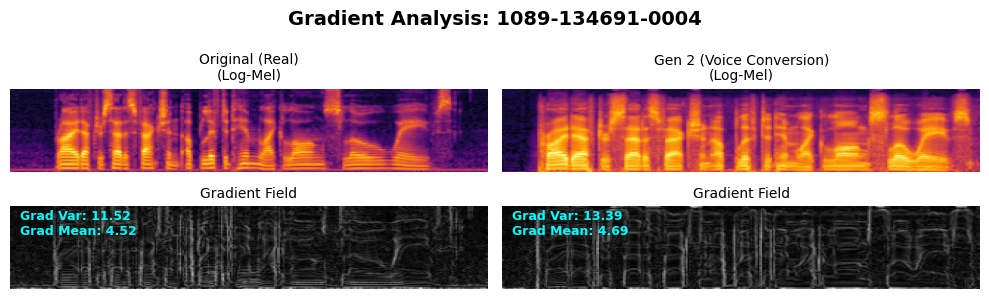

--- Analysis Report for 1089-134691-0004 ---
Real Audio Gradient Variance: 11.5247
[Gen 2 (Voice Conversion)] Diff from Real: 1.8677
--------------------------------------------------


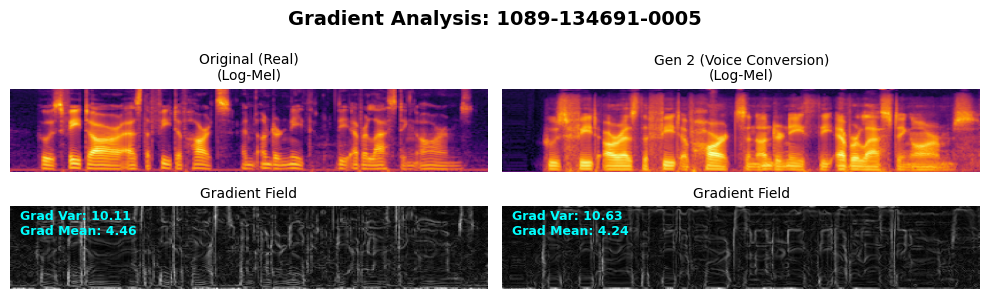

--- Analysis Report for 1089-134691-0005 ---
Real Audio Gradient Variance: 10.1061
[Gen 2 (Voice Conversion)] Diff from Real: 0.5266
--------------------------------------------------


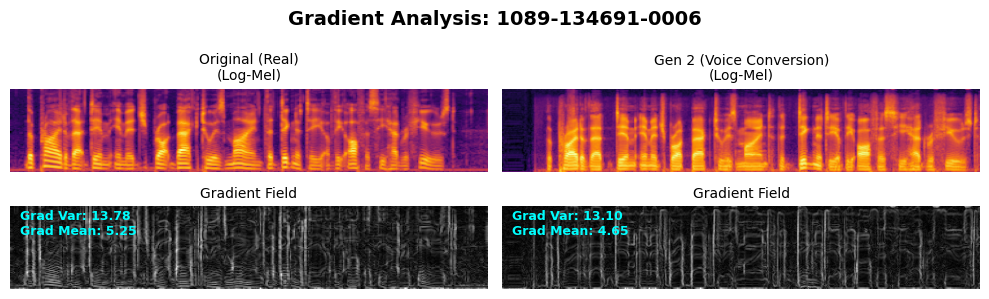

--- Analysis Report for 1089-134691-0006 ---
Real Audio Gradient Variance: 13.7773
[Gen 2 (Voice Conversion)] Diff from Real: -0.6752
--------------------------------------------------


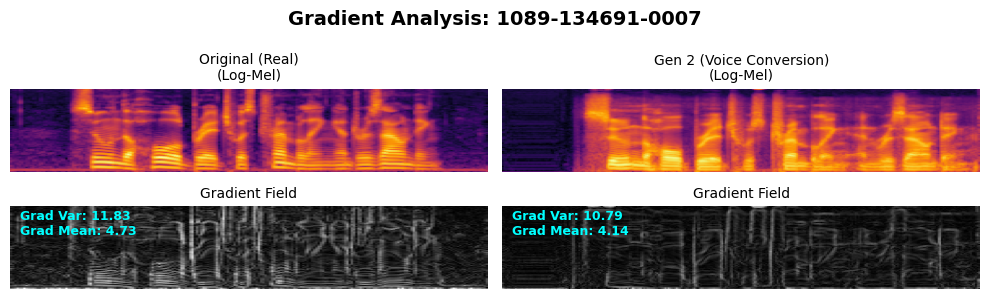

--- Analysis Report for 1089-134691-0007 ---
Real Audio Gradient Variance: 11.8259
[Gen 2 (Voice Conversion)] Diff from Real: -1.0323
--------------------------------------------------


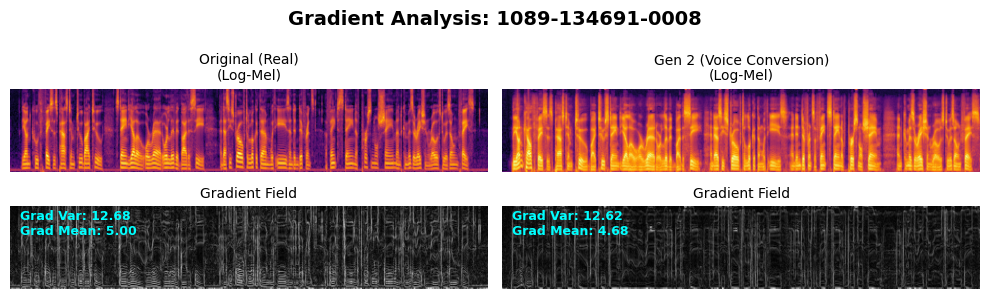

--- Analysis Report for 1089-134691-0008 ---
Real Audio Gradient Variance: 12.6793
[Gen 2 (Voice Conversion)] Diff from Real: -0.0577
--------------------------------------------------


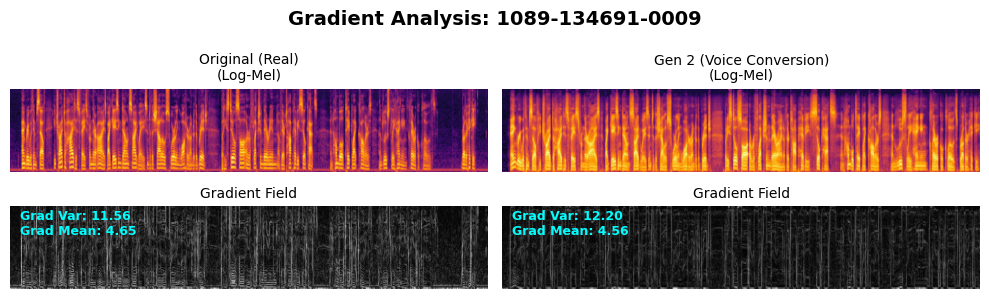

--- Analysis Report for 1089-134691-0009 ---
Real Audio Gradient Variance: 11.5635
[Gen 2 (Voice Conversion)] Diff from Real: 0.6368
--------------------------------------------------


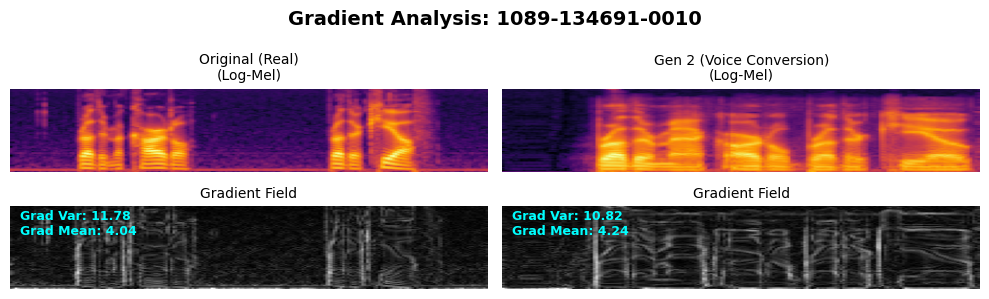

--- Analysis Report for 1089-134691-0010 ---
Real Audio Gradient Variance: 11.7828
[Gen 2 (Voice Conversion)] Diff from Real: -0.9630
--------------------------------------------------


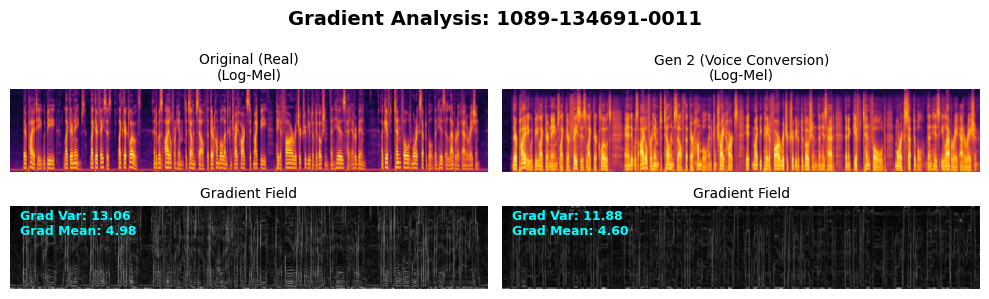

--- Analysis Report for 1089-134691-0011 ---
Real Audio Gradient Variance: 13.0566
[Gen 2 (Voice Conversion)] Diff from Real: -1.1808
--------------------------------------------------


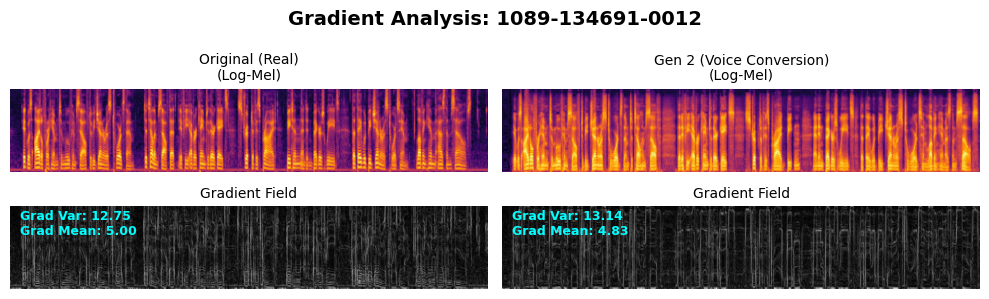

--- Analysis Report for 1089-134691-0012 ---
Real Audio Gradient Variance: 12.7456
[Gen 2 (Voice Conversion)] Diff from Real: 0.3944
--------------------------------------------------


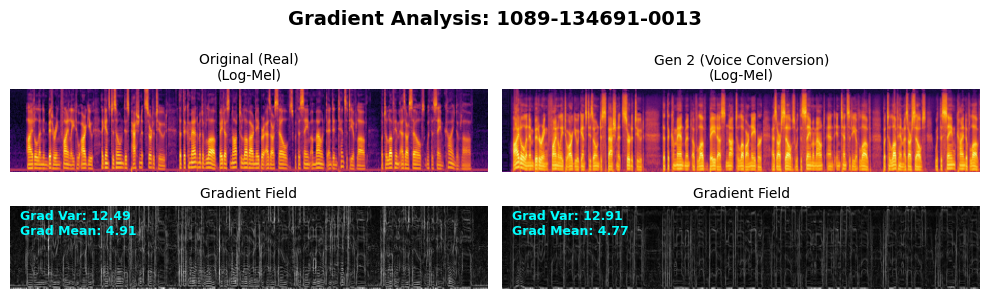

--- Analysis Report for 1089-134691-0013 ---
Real Audio Gradient Variance: 12.4859
[Gen 2 (Voice Conversion)] Diff from Real: 0.4195
--------------------------------------------------


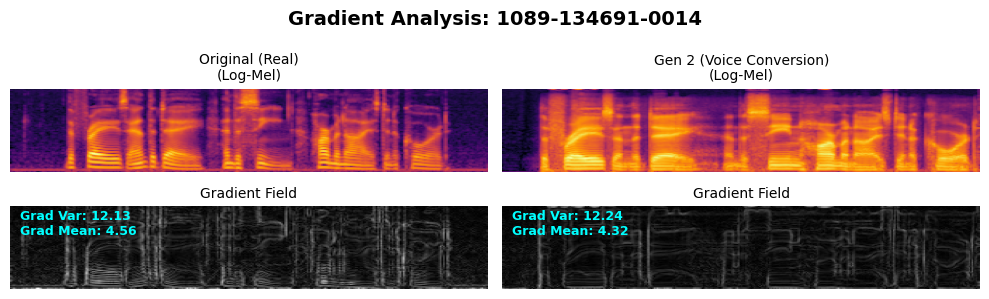

--- Analysis Report for 1089-134691-0014 ---
Real Audio Gradient Variance: 12.1282
[Gen 2 (Voice Conversion)] Diff from Real: 0.1082
--------------------------------------------------


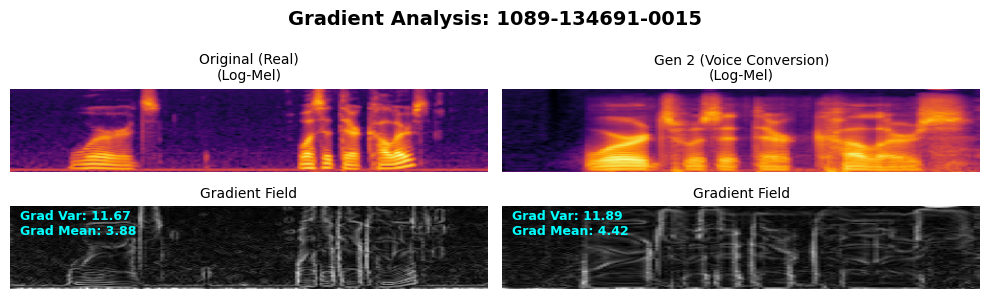

--- Analysis Report for 1089-134691-0015 ---
Real Audio Gradient Variance: 11.6717
[Gen 2 (Voice Conversion)] Diff from Real: 0.2203
--------------------------------------------------


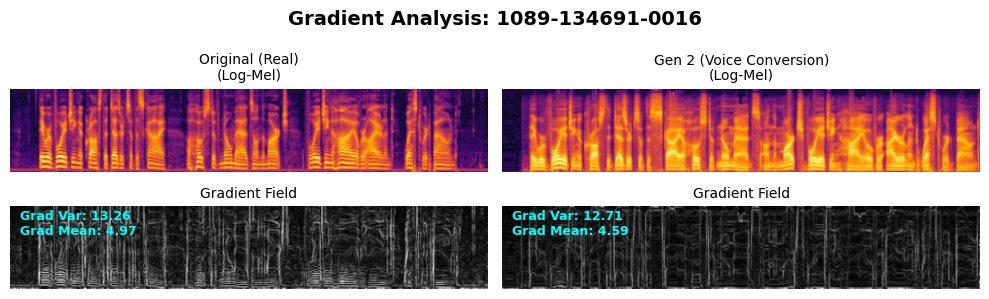

--- Analysis Report for 1089-134691-0016 ---
Real Audio Gradient Variance: 13.2593
[Gen 2 (Voice Conversion)] Diff from Real: -0.5473
--------------------------------------------------


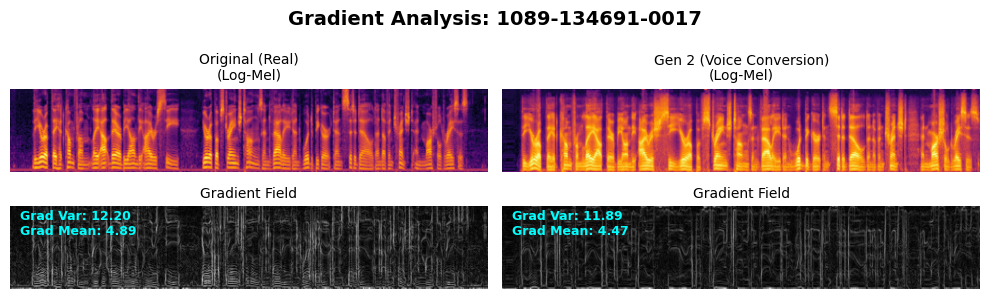

--- Analysis Report for 1089-134691-0017 ---
Real Audio Gradient Variance: 12.2040
[Gen 2 (Voice Conversion)] Diff from Real: -0.3104
--------------------------------------------------


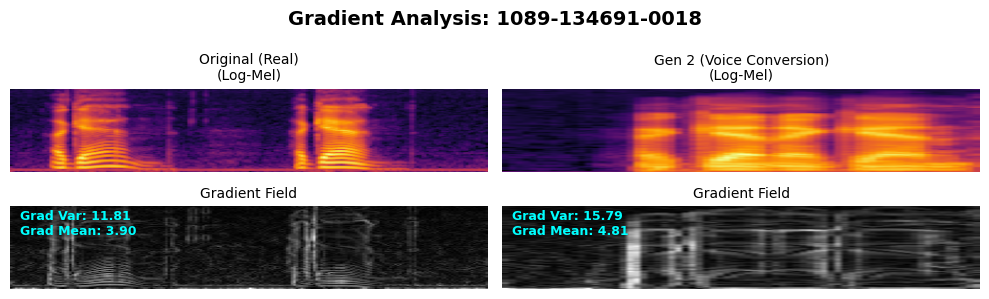

--- Analysis Report for 1089-134691-0018 ---
Real Audio Gradient Variance: 11.8105
[Gen 2 (Voice Conversion)] Diff from Real: 3.9812
--------------------------------------------------


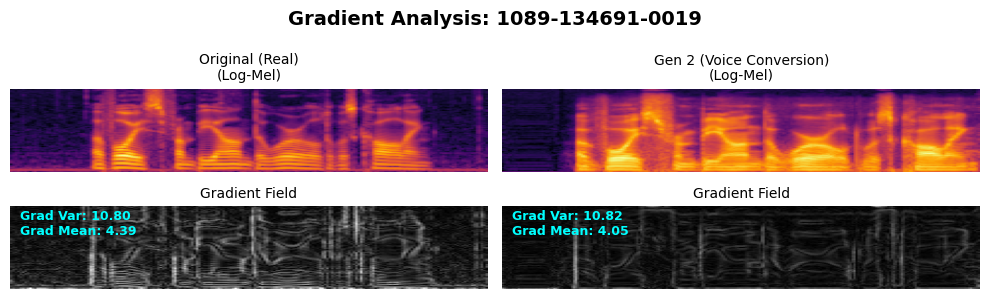

--- Analysis Report for 1089-134691-0019 ---
Real Audio Gradient Variance: 10.8010
[Gen 2 (Voice Conversion)] Diff from Real: 0.0149
--------------------------------------------------


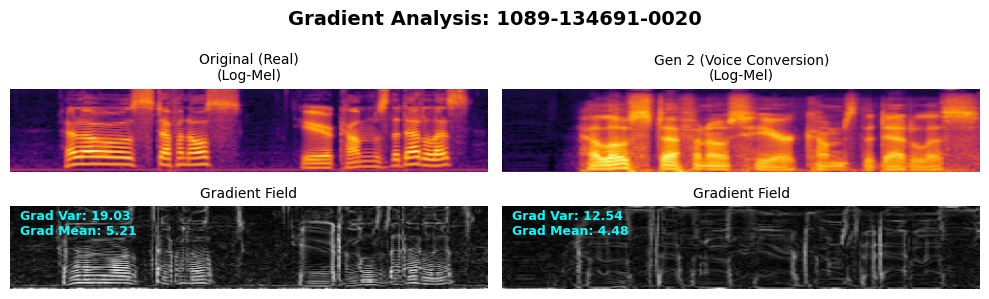

--- Analysis Report for 1089-134691-0020 ---
Real Audio Gradient Variance: 19.0327
[Gen 2 (Voice Conversion)] Diff from Real: -6.4939
--------------------------------------------------


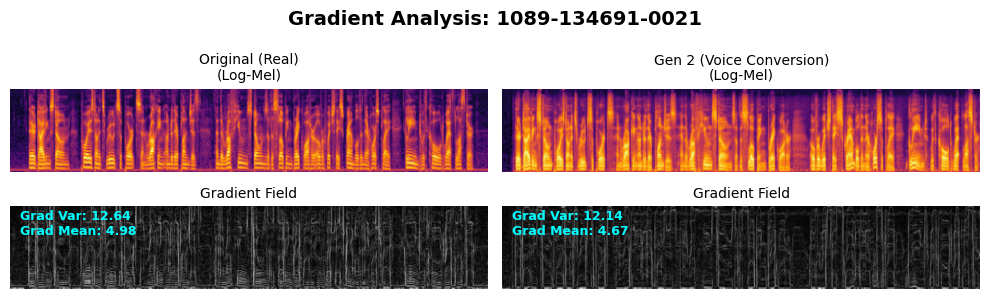

--- Analysis Report for 1089-134691-0021 ---
Real Audio Gradient Variance: 12.6423
[Gen 2 (Voice Conversion)] Diff from Real: -0.5027
--------------------------------------------------


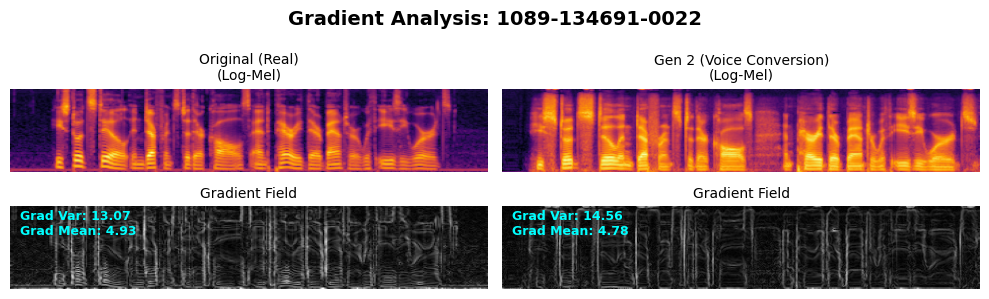

--- Analysis Report for 1089-134691-0022 ---
Real Audio Gradient Variance: 13.0702
[Gen 2 (Voice Conversion)] Diff from Real: 1.4918
--------------------------------------------------


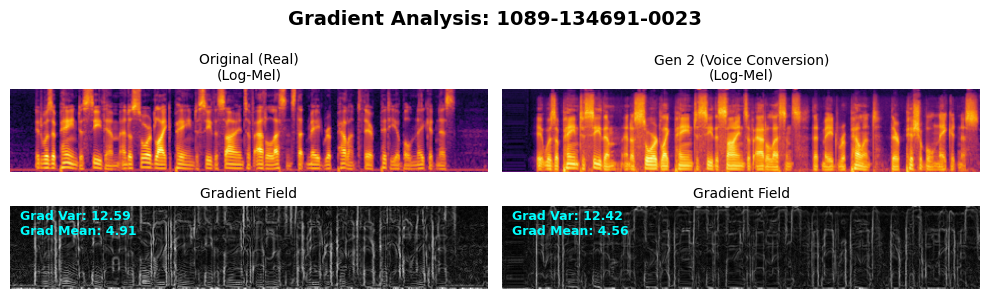

--- Analysis Report for 1089-134691-0023 ---
Real Audio Gradient Variance: 12.5924
[Gen 2 (Voice Conversion)] Diff from Real: -0.1701
--------------------------------------------------


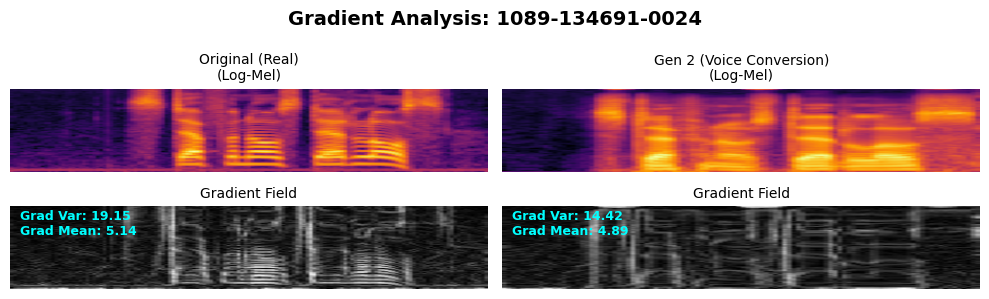

--- Analysis Report for 1089-134691-0024 ---
Real Audio Gradient Variance: 19.1473
[Gen 2 (Voice Conversion)] Diff from Real: -4.7294
--------------------------------------------------


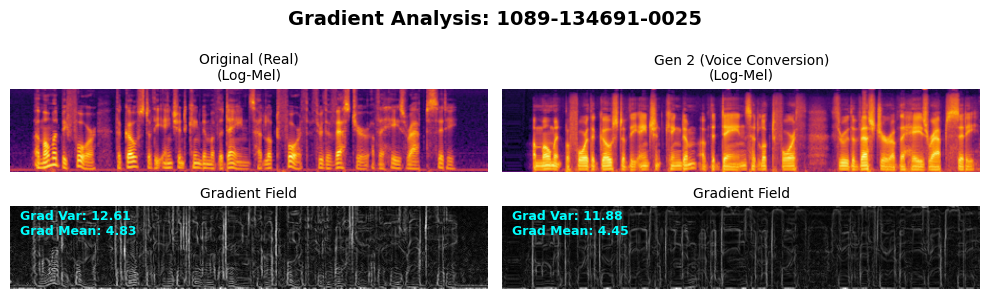

--- Analysis Report for 1089-134691-0025 ---
Real Audio Gradient Variance: 12.6087
[Gen 2 (Voice Conversion)] Diff from Real: -0.7257
--------------------------------------------------


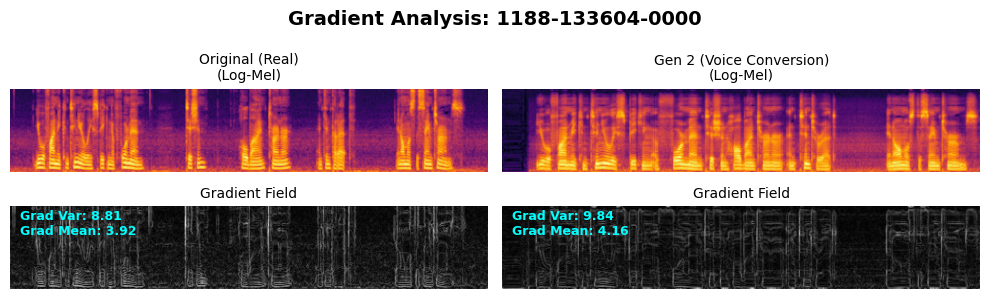

--- Analysis Report for 1188-133604-0000 ---
Real Audio Gradient Variance: 8.8115
[Gen 2 (Voice Conversion)] Diff from Real: 1.0313
--------------------------------------------------


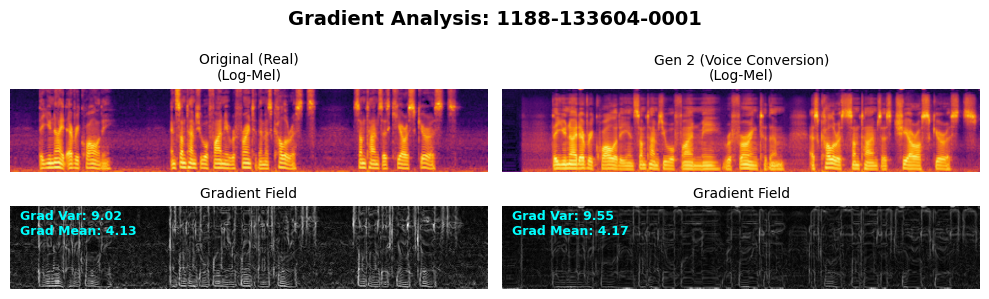

--- Analysis Report for 1188-133604-0001 ---
Real Audio Gradient Variance: 9.0243
[Gen 2 (Voice Conversion)] Diff from Real: 0.5227
--------------------------------------------------


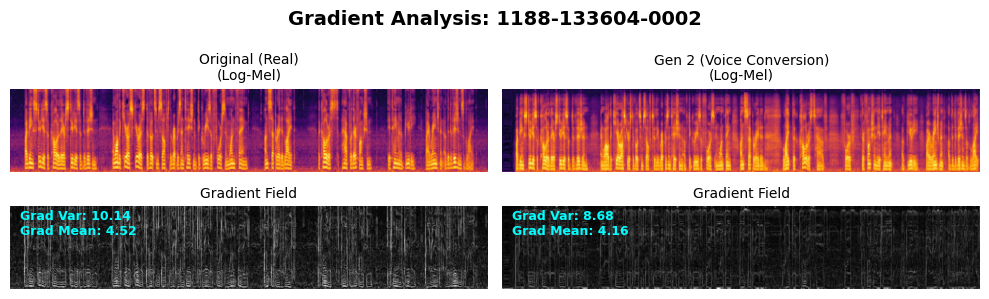

--- Analysis Report for 1188-133604-0002 ---
Real Audio Gradient Variance: 10.1447
[Gen 2 (Voice Conversion)] Diff from Real: -1.4612
--------------------------------------------------


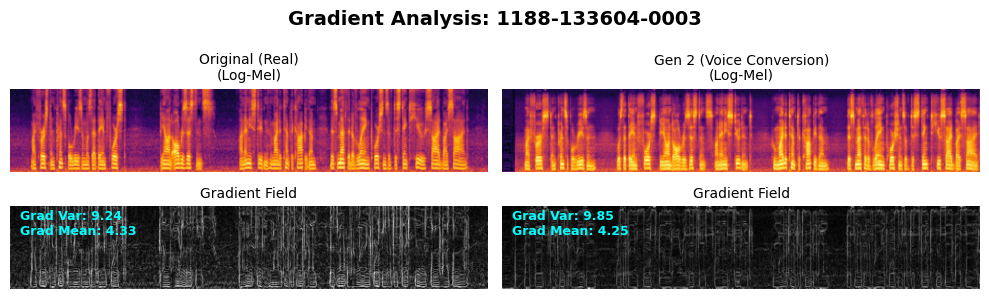

--- Analysis Report for 1188-133604-0003 ---
Real Audio Gradient Variance: 9.2444
[Gen 2 (Voice Conversion)] Diff from Real: 0.6009
--------------------------------------------------


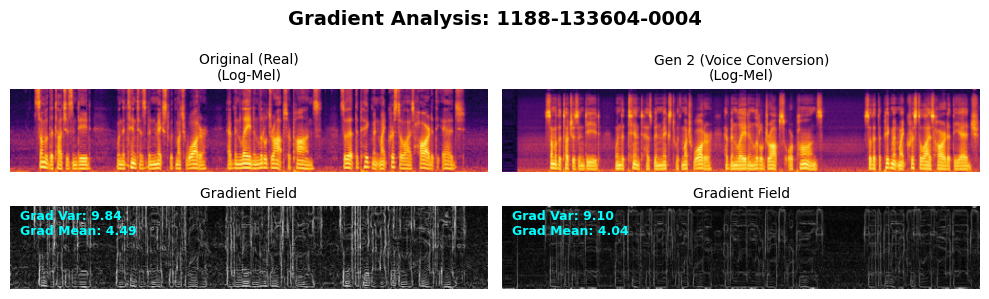

--- Analysis Report for 1188-133604-0004 ---
Real Audio Gradient Variance: 9.8411
[Gen 2 (Voice Conversion)] Diff from Real: -0.7369
--------------------------------------------------


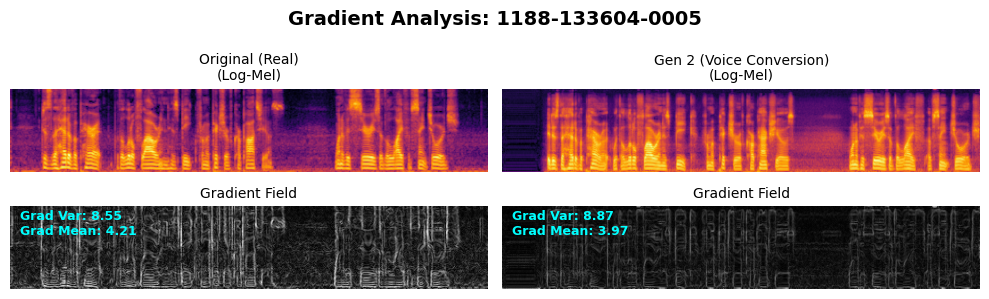

--- Analysis Report for 1188-133604-0005 ---
Real Audio Gradient Variance: 8.5506
[Gen 2 (Voice Conversion)] Diff from Real: 0.3239
--------------------------------------------------


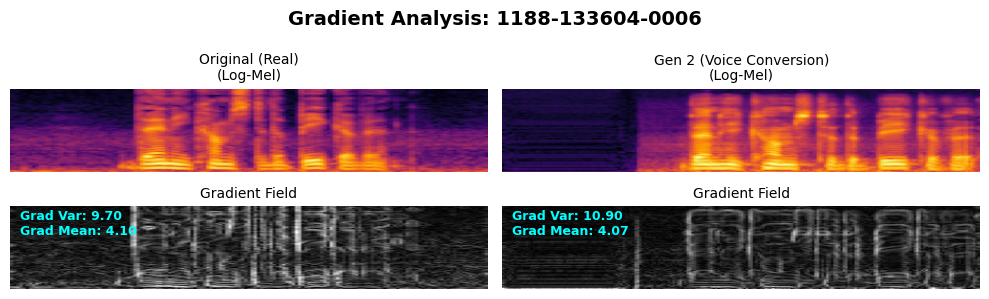

--- Analysis Report for 1188-133604-0006 ---
Real Audio Gradient Variance: 9.6997
[Gen 2 (Voice Conversion)] Diff from Real: 1.2020
--------------------------------------------------


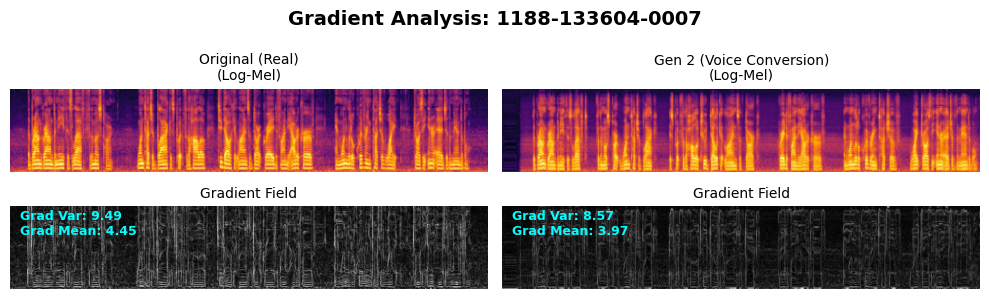

--- Analysis Report for 1188-133604-0007 ---
Real Audio Gradient Variance: 9.4905
[Gen 2 (Voice Conversion)] Diff from Real: -0.9243
--------------------------------------------------


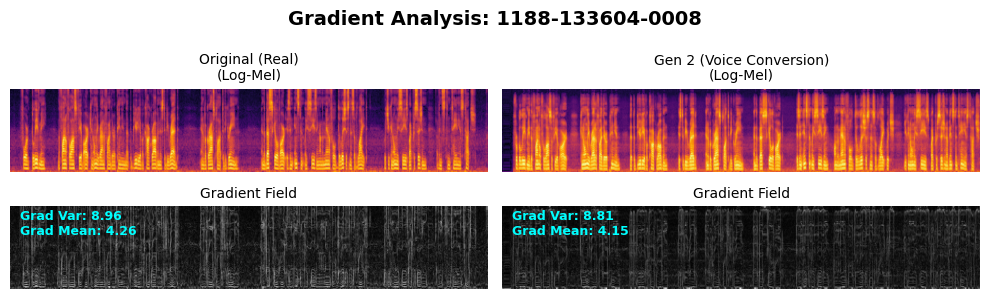

--- Analysis Report for 1188-133604-0008 ---
Real Audio Gradient Variance: 8.9639
[Gen 2 (Voice Conversion)] Diff from Real: -0.1550
--------------------------------------------------


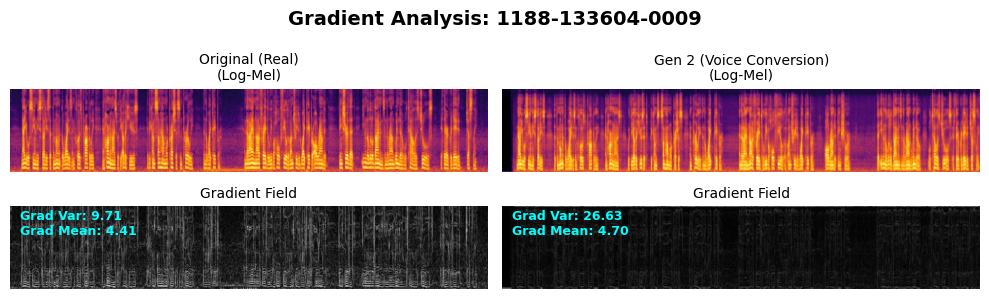

--- Analysis Report for 1188-133604-0009 ---
Real Audio Gradient Variance: 9.7145
[Gen 2 (Voice Conversion)] Diff from Real: 16.9185
--------------------------------------------------


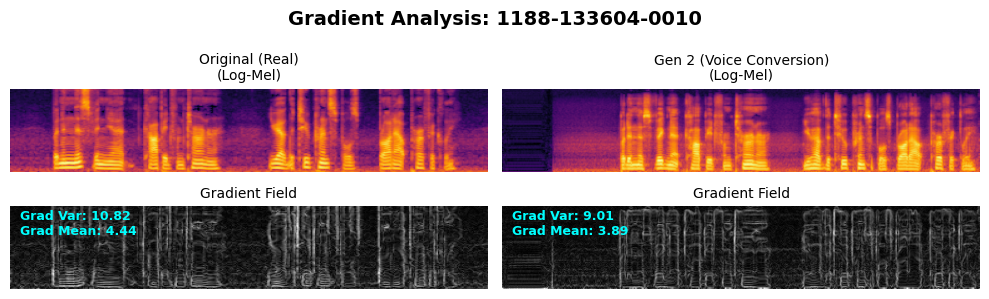

--- Analysis Report for 1188-133604-0010 ---
Real Audio Gradient Variance: 10.8221
[Gen 2 (Voice Conversion)] Diff from Real: -1.8083
--------------------------------------------------


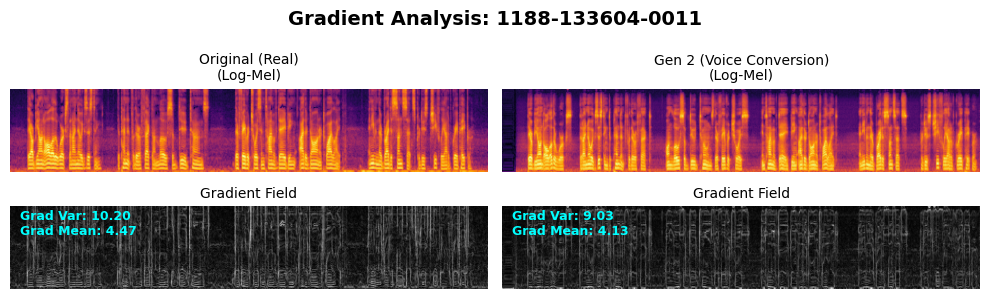

--- Analysis Report for 1188-133604-0011 ---
Real Audio Gradient Variance: 10.1959
[Gen 2 (Voice Conversion)] Diff from Real: -1.1681
--------------------------------------------------


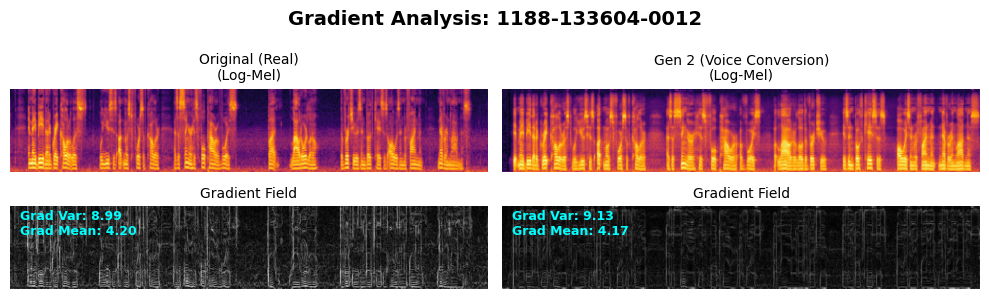

--- Analysis Report for 1188-133604-0012 ---
Real Audio Gradient Variance: 8.9881
[Gen 2 (Voice Conversion)] Diff from Real: 0.1465
--------------------------------------------------


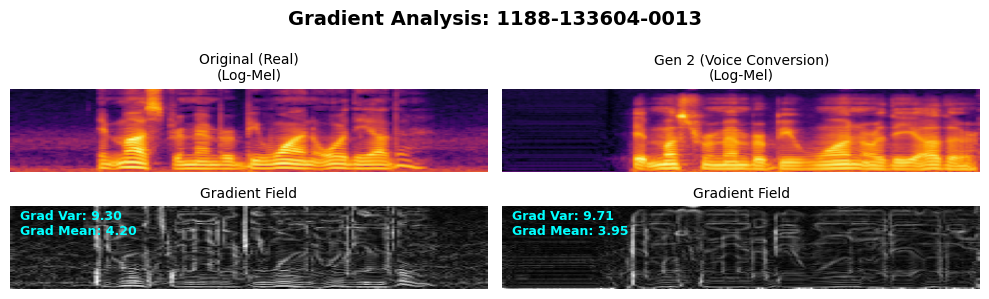

--- Analysis Report for 1188-133604-0013 ---
Real Audio Gradient Variance: 9.2957
[Gen 2 (Voice Conversion)] Diff from Real: 0.4172
--------------------------------------------------


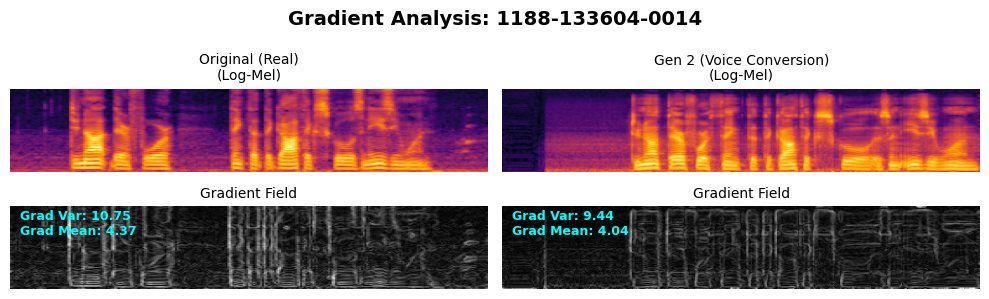

--- Analysis Report for 1188-133604-0014 ---
Real Audio Gradient Variance: 10.7525
[Gen 2 (Voice Conversion)] Diff from Real: -1.3135
--------------------------------------------------


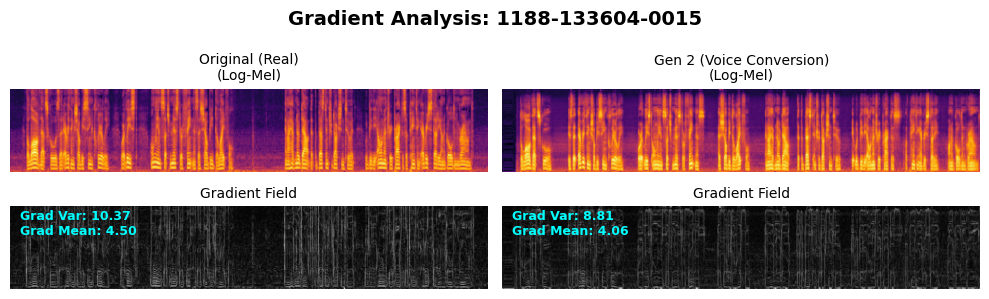

--- Analysis Report for 1188-133604-0015 ---
Real Audio Gradient Variance: 10.3700
[Gen 2 (Voice Conversion)] Diff from Real: -1.5576
--------------------------------------------------


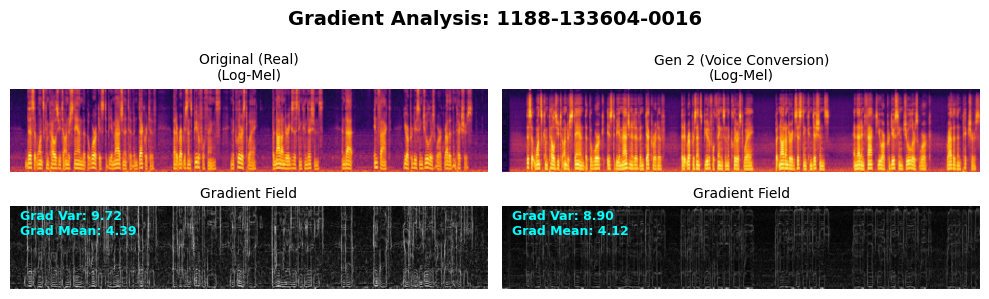

--- Analysis Report for 1188-133604-0016 ---
Real Audio Gradient Variance: 9.7249
[Gen 2 (Voice Conversion)] Diff from Real: -0.8263
--------------------------------------------------


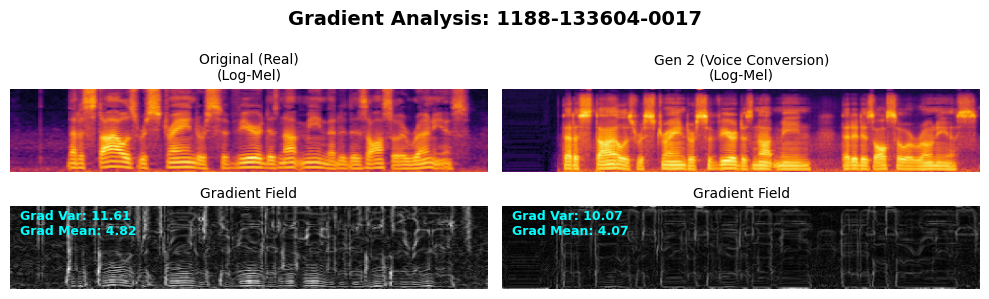

--- Analysis Report for 1188-133604-0017 ---
Real Audio Gradient Variance: 11.6094
[Gen 2 (Voice Conversion)] Diff from Real: -1.5350
--------------------------------------------------


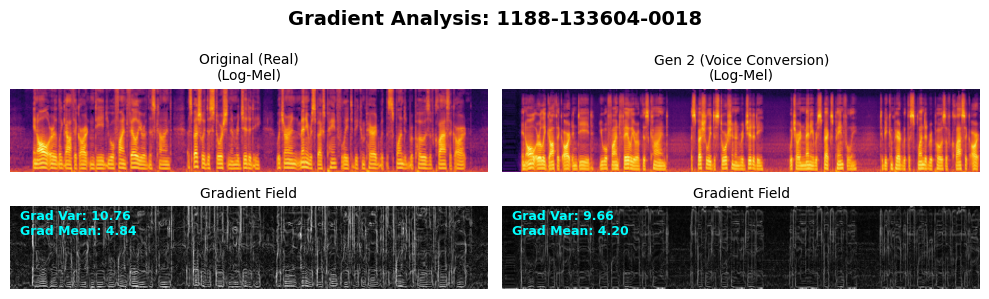

--- Analysis Report for 1188-133604-0018 ---
Real Audio Gradient Variance: 10.7633
[Gen 2 (Voice Conversion)] Diff from Real: -1.1063
--------------------------------------------------


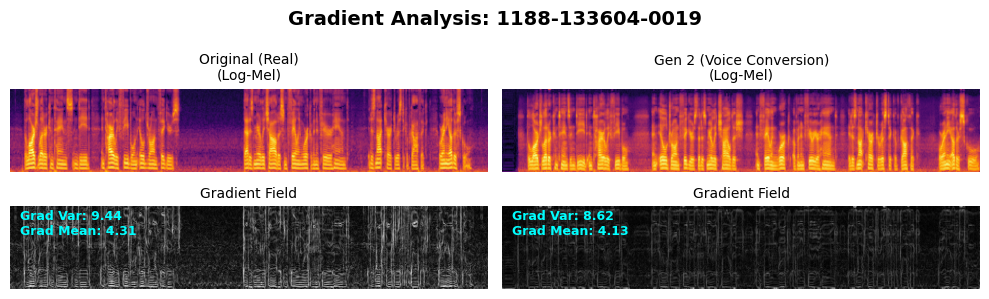

--- Analysis Report for 1188-133604-0019 ---
Real Audio Gradient Variance: 9.4391
[Gen 2 (Voice Conversion)] Diff from Real: -0.8202
--------------------------------------------------


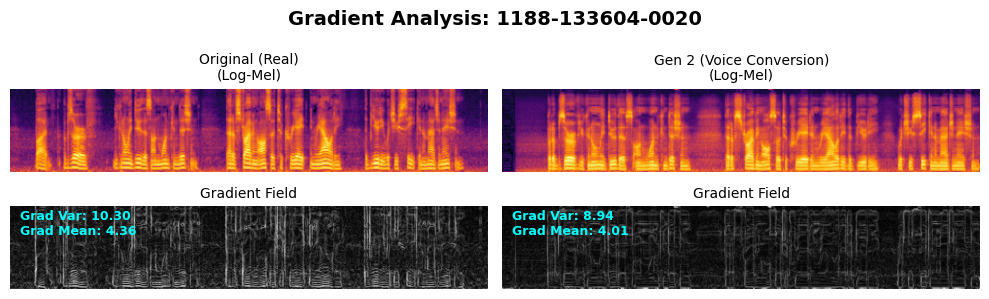

--- Analysis Report for 1188-133604-0020 ---
Real Audio Gradient Variance: 10.2974
[Gen 2 (Voice Conversion)] Diff from Real: -1.3549
--------------------------------------------------


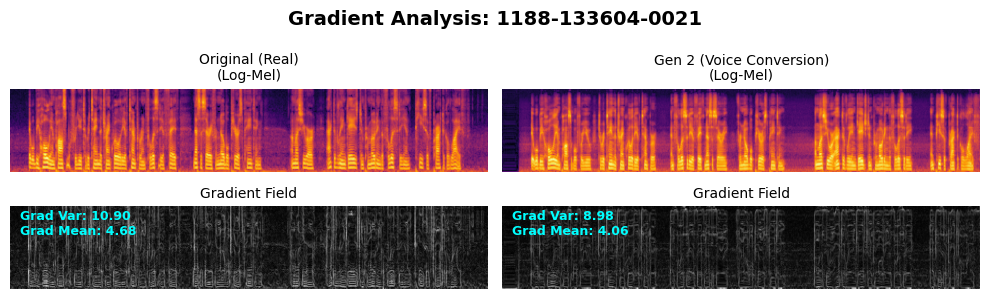

--- Analysis Report for 1188-133604-0021 ---
Real Audio Gradient Variance: 10.9027
[Gen 2 (Voice Conversion)] Diff from Real: -1.9216
--------------------------------------------------


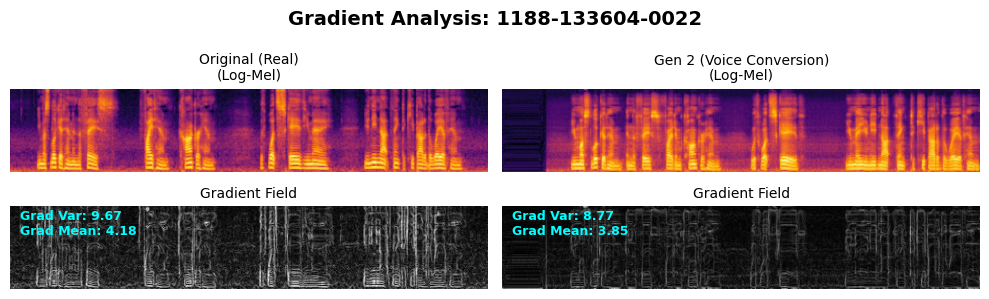

--- Analysis Report for 1188-133604-0022 ---
Real Audio Gradient Variance: 9.6651
[Gen 2 (Voice Conversion)] Diff from Real: -0.8978
--------------------------------------------------


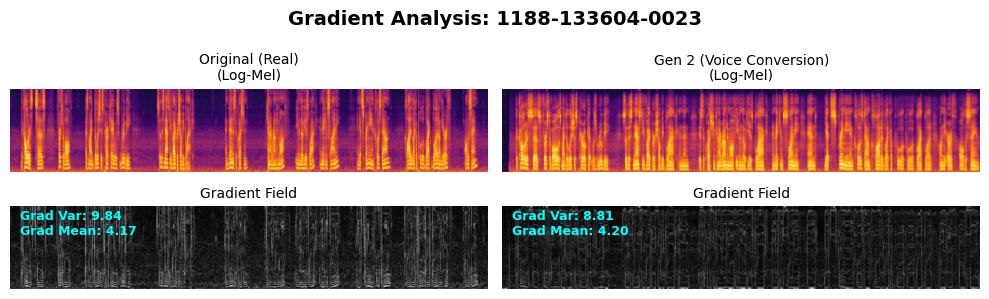

--- Analysis Report for 1188-133604-0023 ---
Real Audio Gradient Variance: 9.8350
[Gen 2 (Voice Conversion)] Diff from Real: -1.0219
--------------------------------------------------


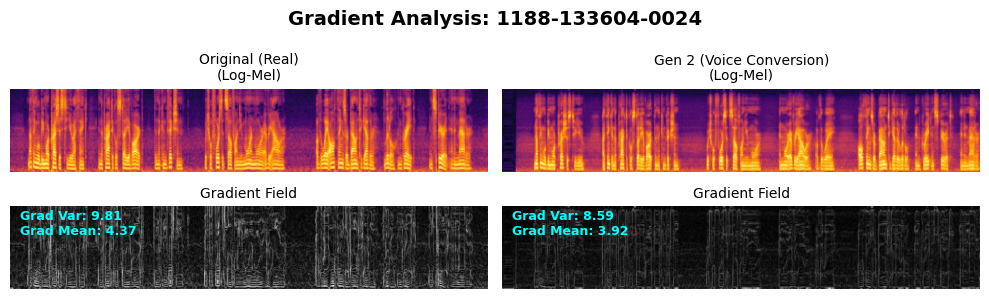

--- Analysis Report for 1188-133604-0024 ---
Real Audio Gradient Variance: 9.8070
[Gen 2 (Voice Conversion)] Diff from Real: -1.2122
--------------------------------------------------


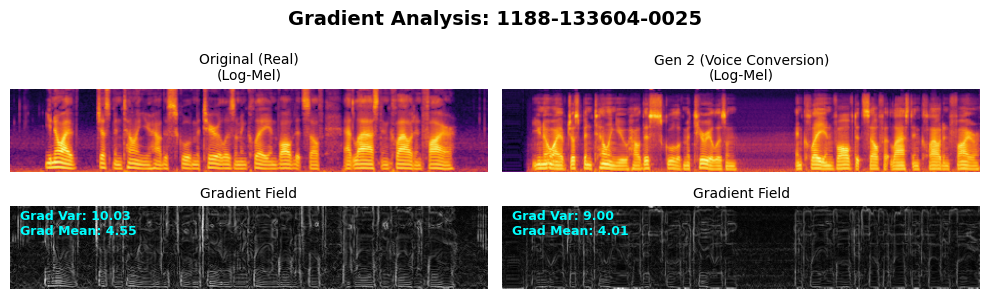

--- Analysis Report for 1188-133604-0025 ---
Real Audio Gradient Variance: 10.0349
[Gen 2 (Voice Conversion)] Diff from Real: -1.0347
--------------------------------------------------


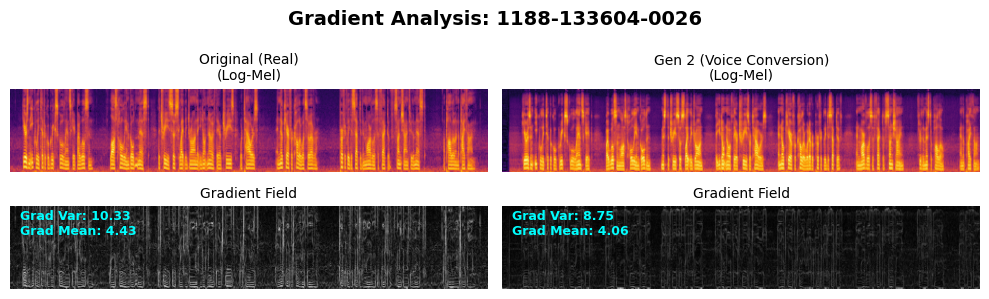

--- Analysis Report for 1188-133604-0026 ---
Real Audio Gradient Variance: 10.3283
[Gen 2 (Voice Conversion)] Diff from Real: -1.5766
--------------------------------------------------


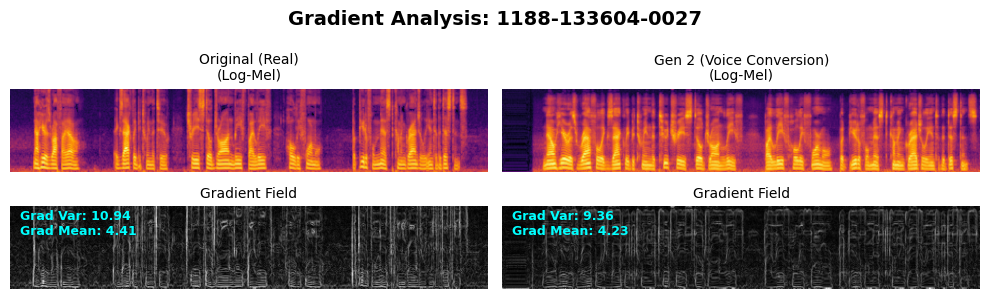

--- Analysis Report for 1188-133604-0027 ---
Real Audio Gradient Variance: 10.9408
[Gen 2 (Voice Conversion)] Diff from Real: -1.5799
--------------------------------------------------


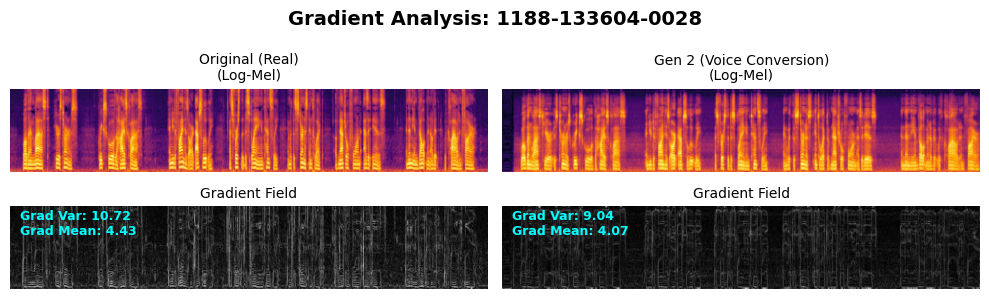

--- Analysis Report for 1188-133604-0028 ---
Real Audio Gradient Variance: 10.7224
[Gen 2 (Voice Conversion)] Diff from Real: -1.6854
--------------------------------------------------


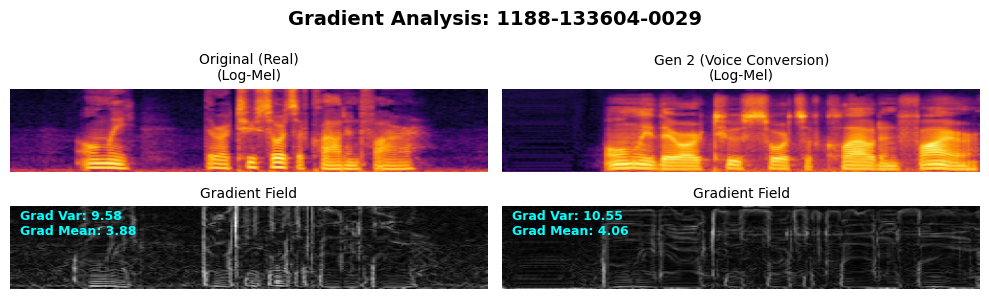

--- Analysis Report for 1188-133604-0029 ---
Real Audio Gradient Variance: 9.5820
[Gen 2 (Voice Conversion)] Diff from Real: 0.9654
--------------------------------------------------


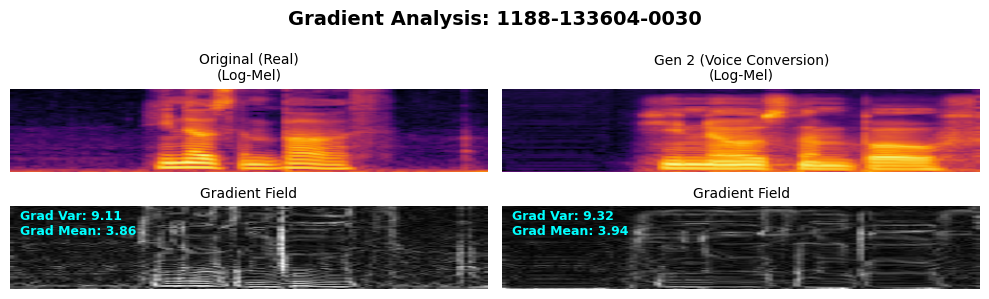

--- Analysis Report for 1188-133604-0030 ---
Real Audio Gradient Variance: 9.1110
[Gen 2 (Voice Conversion)] Diff from Real: 0.2115
--------------------------------------------------


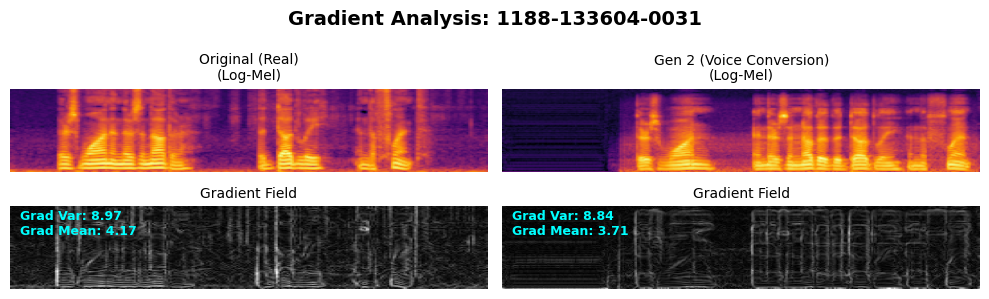

--- Analysis Report for 1188-133604-0031 ---
Real Audio Gradient Variance: 8.9725
[Gen 2 (Voice Conversion)] Diff from Real: -0.1320
--------------------------------------------------


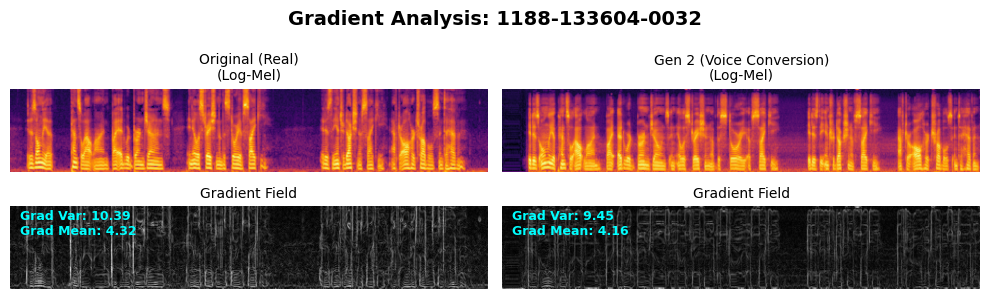

--- Analysis Report for 1188-133604-0032 ---
Real Audio Gradient Variance: 10.3920
[Gen 2 (Voice Conversion)] Diff from Real: -0.9405
--------------------------------------------------


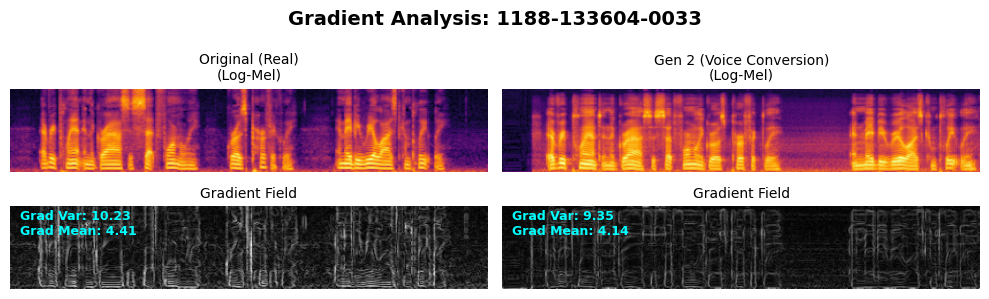

--- Analysis Report for 1188-133604-0033 ---
Real Audio Gradient Variance: 10.2311
[Gen 2 (Voice Conversion)] Diff from Real: -0.8832
--------------------------------------------------


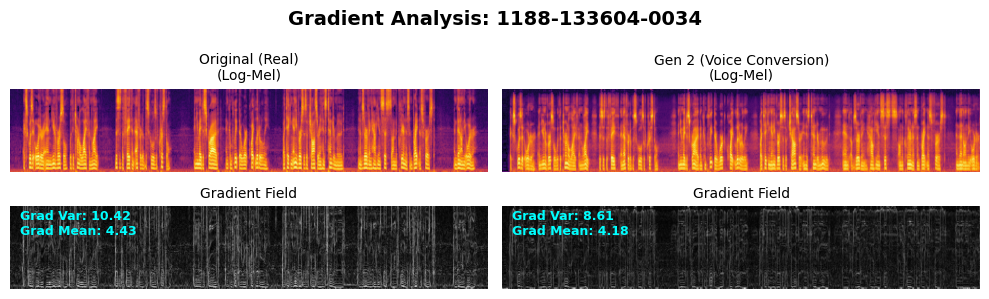

--- Analysis Report for 1188-133604-0034 ---
Real Audio Gradient Variance: 10.4181
[Gen 2 (Voice Conversion)] Diff from Real: -1.8036
--------------------------------------------------


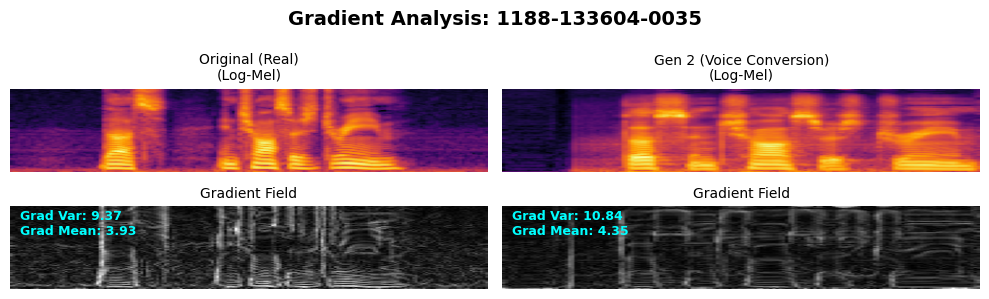

--- Analysis Report for 1188-133604-0035 ---
Real Audio Gradient Variance: 9.3673
[Gen 2 (Voice Conversion)] Diff from Real: 1.4725
--------------------------------------------------


In [ ]:

#실행 예시 (dataframe_1000이 정의되어 있다고 가정)
for idx, row in enumerate(dataframe_1000.to_dict('records')):
    visualize_triplet_analysis(row, idx)

Processed 10 rows...
Processed 20 rows...
Processed 30 rows...
Processed 40 rows...
Processed 50 rows...
Processed 60 rows...
Processed 70 rows...
Processed 80 rows...
Processed 90 rows...
Processed 100 rows...
Data collection complete. Plotting results...
Drawing arrows...


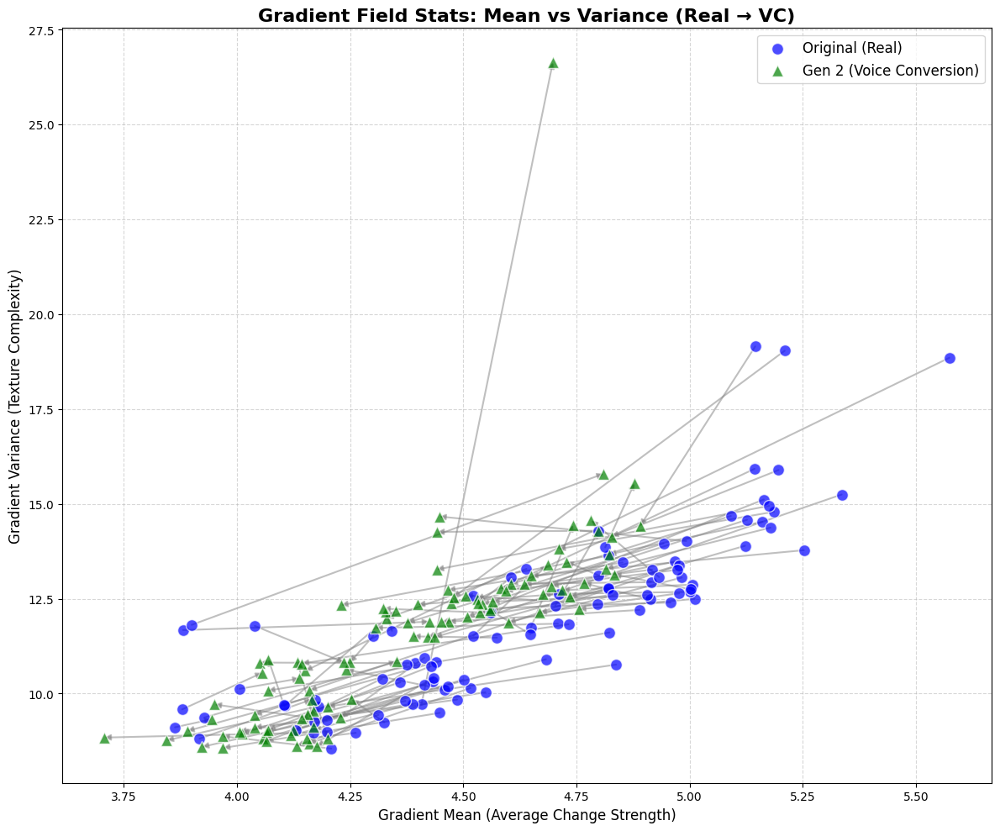

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
from pathlib import Path

# 데이터를 저장할 딕셔너리 (파일명 기준으로 매칭하기 위함)
# 구조: { 'file_name': {'Original': (mean, var), 'Gen 2': (mean, var)} }
file_metrics = {}

# 색상 및 마커 설정 (Gen 1 제외)
styles = {
    "Original (Real)": {'color': 'blue', 'marker': 'o', 'label': 'Original (Real)'},
    "Gen 2 (Voice Conversion)": {'color': 'green', 'marker': '^', 'label': 'Gen 2 (Voice Conversion)'}
}

print("Collecting data metrics...")

# dataframe_10의 모든 행에 대해 데이터 수집
for i, row in enumerate(dataframe_1000.to_dict('records')):
    base_name = Path(row['audio_path']).stem
    speaker_id = row['speaker_id']
    
    # 딕셔너리 초기화
    if base_name not in file_metrics:
        file_metrics[base_name] = {}

    # 2가지 타입(Original, Gen 2)의 파일 경로 정의
    file_paths = {
        "Original (Real)": Path(row['audio_path']).resolve(),
        "Gen 2 (Voice Conversion)": Path(f"generated_results_F5_Fixed/gen_{i:03d}_{speaker_id}.wav")
    }
    
    for group_name, path in file_paths.items():
        if not path.exists():
            continue
            
        # 1. Mel Spectrogram 계산
        mel = compute_mel_spectrogram(str(path))
        if mel is None:
            continue
            
        # 2. Gradient Field 수치 추출 (Mean, Variance)
        _, var, mean = compute_gradient_field(mel)
        
        # 3. 데이터 저장 (파일명 키 아래에 그룹별로 저장)
        file_metrics[base_name][group_name] = (mean, var)

    # 진행 상황 표시
    if (i + 1) % 10 == 0:
        print(f"Processed {i + 1} rows...")

print("Data collection complete. Plotting results...")

# --- 시각화 (Scatter Plot + Arrows) ---
plt.figure(figsize=(12, 10))

# 1. 점 찍기 (Scatter)
# 범례(Legend)를 위해 그룹별로 모아서 한 번씩 찍습니다.
for group_name in styles.keys():
    means = []
    vars = []
    
    for name, metrics in file_metrics.items():
        if group_name in metrics:
            means.append(metrics[group_name][0]) # mean
            vars.append(metrics[group_name][1])  # var
            
    if means:
        plt.scatter(means, vars, 
                    c=styles[group_name]['color'], 
                    marker=styles[group_name]['marker'], 
                    label=styles[group_name]['label'], 
                    alpha=0.7, s=100, edgecolors='white', zorder=2)

# 2. 화살표 그리기 (Arrows)
print("Drawing arrows...")
for name, metrics in file_metrics.items():
    # Original과 Gen 2 데이터가 둘 다 있는 경우에만 화살표 연결
    if "Original (Real)" in metrics and "Gen 2 (Voice Conversion)" in metrics:
        start_pos = metrics["Original (Real)"]         # (mean, var)
        end_pos = metrics["Gen 2 (Voice Conversion)"]  # (mean, var)
        
        plt.annotate(
            "", 
            xy=end_pos,            # 화살표 머리 (Gen 2)
            xytext=start_pos,      # 화살표 꼬리 (Original)
            arrowprops=dict(
                arrowstyle="-|>", 
                color='gray', 
                alpha=0.5, 
                linewidth=1.5,
                shrinkA=0, shrinkB=0
            ),
            zorder=1
        )

# 그래프 꾸미기
plt.title("Gradient Field Stats: Mean vs Variance (Real → VC)", fontsize=16, fontweight='bold')
plt.xlabel("Gradient Mean (Average Change Strength)", fontsize=12)
plt.ylabel("Gradient Variance (Texture Complexity)", fontsize=12)
plt.legend(fontsize=12)
plt.grid(True, linestyle='--', alpha=0.5)

plt.tight_layout()
plt.show()

Starting feature extraction for PCA (Original vs Gen 2)...


Feature extraction complete. Data shape: (200, 20480)
Running PCA...
Explained variance ratio: [0.074223  0.0257307]
Drawing arrows...


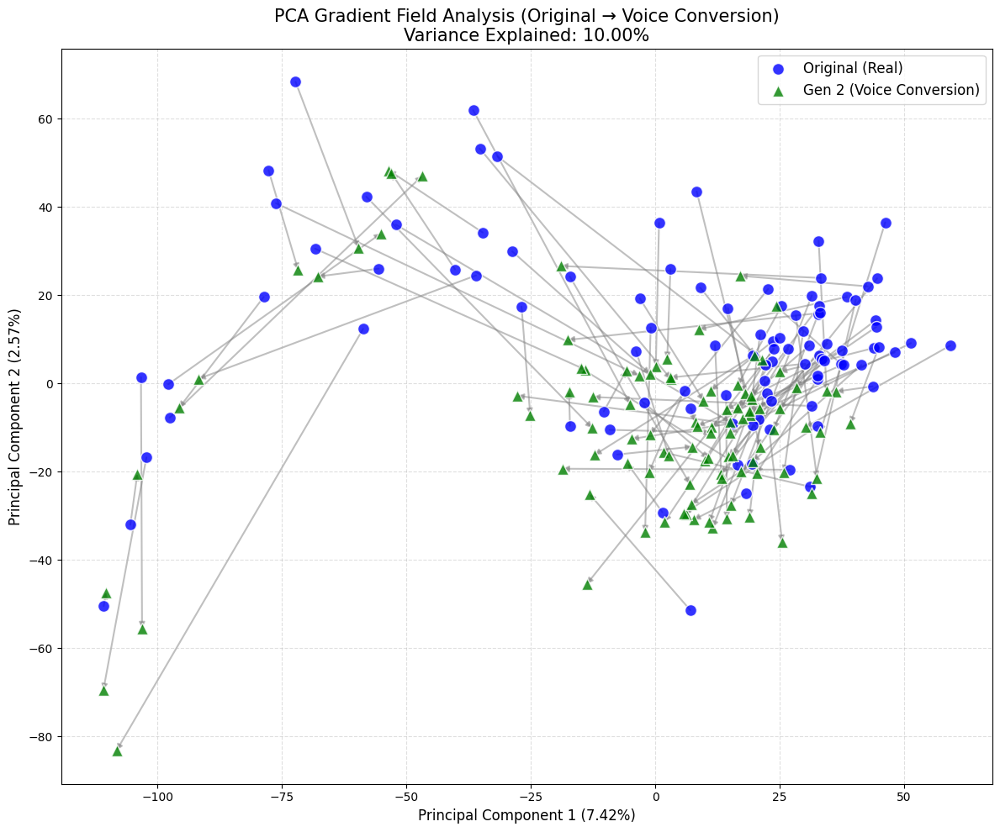

In [ ]:
import matplotlib.pyplot as plt
import torchaudio
import torch
import numpy as np
from pathlib import Path
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

# --- 1. 설정 및 헬퍼 함수 (기존과 동일) ---

TARGET_WIDTH = 256  

def resize_spectrogram(spec_tensor, target_width=TARGET_WIDTH):
    n_mels, width = spec_tensor.shape
    if width > target_width:
        start = (width - target_width) // 2
        return spec_tensor[:, start:start+target_width]
    elif width < target_width:
        pad_width = target_width - width
        return torch.nn.functional.pad(spec_tensor, (0, pad_width, 0, 0))
    return spec_tensor

def compute_mel_spectrogram_resized(audio_path, n_mels=80, target_width=TARGET_WIDTH):
    try:
        waveform, sr = torchaudio.load(audio_path)
        mel = torchaudio.transforms.MelSpectrogram(
            sample_rate=sr, n_fft=1024, hop_length=256, n_mels=n_mels, normalized=True
        )(waveform)
        mel_db = torchaudio.functional.amplitude_to_DB(mel, multiplier=10.0, amin=1e-10, db_multiplier=1.0)
        mel_db = mel_db.squeeze(0)
        return resize_spectrogram(mel_db, target_width)
    except Exception as e:
        print(f"Error loading {audio_path}: {e}")
        return None

def compute_flattened_gradient(mel_tensor):
    mel_np = mel_tensor.numpy()
    grad_y, grad_x = np.gradient(mel_np)
    gradient_magnitude = np.sqrt(grad_x**2 + grad_y**2)
    return gradient_magnitude.flatten()

# --- 2. 데이터 수집 (Original & Gen 2 Only) ---

features = [] 
labels = []   
filenames = [] # 화살표 연결을 위해 파일명 저장

# 분석할 대상 그룹 정의 (Gen 1 제외)
target_groups = ["Original (Real)", "Gen 2 (Voice Conversion)"]
label_map = {name: i for i, name in enumerate(target_groups)}
colors = ['blue', 'green'] # 파랑: 원본, 초록: 변환
markers = ['o', '^']

print("Starting feature extraction for PCA (Original vs Gen 2)...")

for i, row in enumerate(dataframe_1000.to_dict('records')):
    base_name = Path(row['audio_path']).stem
    speaker_id = row['speaker_id']
    
    # 두 가지 경로만 설정
    file_paths = {
        "Original (Real)": Path(row['audio_path']).resolve(),
        "Gen 2 (Voice Conversion)": Path(f"generated_results_F5_Fixed/gen_{i:03d}_{speaker_id}.wav")
    }
    
    for group_name, path in file_paths.items():
        if not path.exists(): continue
            
        mel = compute_mel_spectrogram_resized(str(path))
        if mel is None: continue
            
        flattened_vec = compute_flattened_gradient(mel)
        
        features.append(flattened_vec)
        labels.append(label_map[group_name])
        filenames.append(base_name) # 파일명 저장

X = np.array(features)
y = np.array(labels)

print(f"Feature extraction complete. Data shape: {X.shape}")

# --- 3. PCA 수행 ---

print("Running PCA...")
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled)

explained_variance = pca.explained_variance_ratio_
print(f"Explained variance ratio: {explained_variance}")

# --- 4. 시각화 (화살표 포함) ---

plt.figure(figsize=(12, 10))

# 4-1. 산점도 그리기
for target_idx, group_name in enumerate(target_groups):
    mask = (y == target_idx)
    plt.scatter(
        X_pca[mask, 0], 
        X_pca[mask, 1],
        color=colors[target_idx],
        marker=markers[target_idx],
        label=group_name,
        alpha=0.8, s=100, edgecolors='white',
        zorder=2
    )

# 4-2. 화살표 그리기 (Original -> Gen 2)
print("Drawing arrows...")
unique_files = sorted(list(set(filenames)))

for base_name in unique_files:
    # 현재 파일명에 해당하는 인덱스 찾기
    orig_indices = [idx for idx, (f, l) in enumerate(zip(filenames, labels)) if f == base_name and l == 0]
    gen2_indices = [idx for idx, (f, l) in enumerate(zip(filenames, labels)) if f == base_name and l == 1]

    if orig_indices and gen2_indices:
        start_pos = X_pca[orig_indices[0]] # Original 위치
        end_pos = X_pca[gen2_indices[0]]   # Gen 2 위치

        plt.annotate(
            "", 
            xy=end_pos, 
            xytext=start_pos,
            arrowprops=dict(
                arrowstyle="-|>", 
                color='gray', 
                alpha=0.5, 
                linewidth=1.5,
                shrinkA=0, shrinkB=0
            ),
            zorder=1
        )

# 그래프 꾸미기
plt.title(f"PCA Gradient Field Analysis (Original → Voice Conversion)\nVariance Explained: {sum(explained_variance)*100:.2f}%", fontsize=15)
plt.xlabel(f"Principal Component 1 ({explained_variance[0]*100:.2f}%)", fontsize=12)
plt.ylabel(f"Principal Component 2 ({explained_variance[1]*100:.2f}%)", fontsize=12)
plt.legend(fontsize=12)
plt.grid(True, linestyle='--', alpha=0.4)

plt.tight_layout()
plt.show()

Extracting features...
Data shape: (200, 20480)
Running t-SNE (Perplexity: 30)...
Drawing arrows...


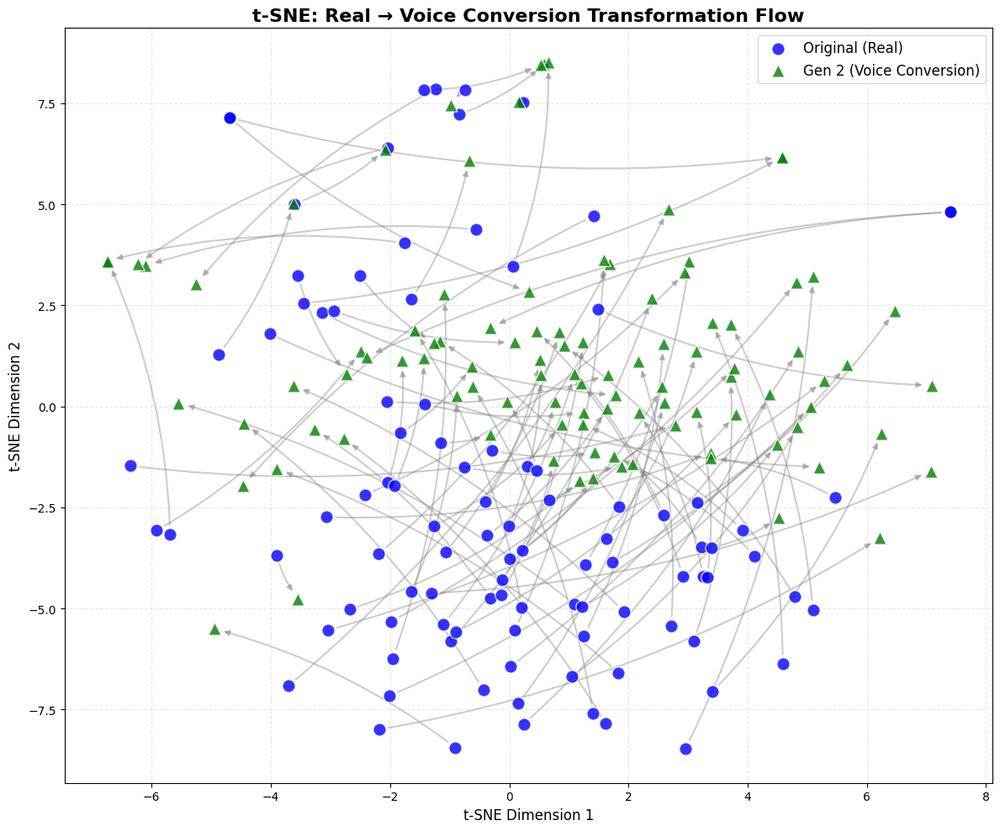

In [ ]:
import matplotlib.pyplot as plt
import torchaudio
import torch
import numpy as np
from pathlib import Path
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

# --- 1. 설정 및 헬퍼 함수 (기존과 동일) ---

TARGET_WIDTH = 256

def resize_spectrogram(spec_tensor, target_width=TARGET_WIDTH):
    n_mels, width = spec_tensor.shape
    if width > target_width:
        start = (width - target_width) // 2
        return spec_tensor[:, start:start+target_width]
    elif width < target_width:
        pad_width = target_width - width
        return torch.nn.functional.pad(spec_tensor, (0, pad_width, 0, 0))
    return spec_tensor

def compute_mel_and_flatten_grad(audio_path, n_mels=80):
    try:
        waveform, sr = torchaudio.load(audio_path)
        mel = torchaudio.transforms.MelSpectrogram(
            sample_rate=sr, n_fft=1024, hop_length=256, n_mels=n_mels, normalized=True
        )(waveform)
        mel_db = torchaudio.functional.amplitude_to_DB(mel, multiplier=10.0, amin=1e-10, db_multiplier=1.0)
        mel_resized = resize_spectrogram(mel_db.squeeze(0))
        mel_np = mel_resized.numpy()
        grad_y, grad_x = np.gradient(mel_np)
        grad_mag = np.sqrt(grad_x**2 + grad_y**2)
        return grad_mag.flatten()
    except Exception as e:
        return None

# --- 2. 데이터 수집 (Original vs Gen 2) ---

features = []
labels = []
filenames = [] # 화살표 연결을 위해 파일명 저장

target_groups = ["Original (Real)", "Gen 2 (Voice Conversion)"]
label_map = {name: i for i, name in enumerate(target_groups)}
colors = ['blue', 'green']
markers = ['o', '^']

print("Extracting features...")
for i, row in enumerate(dataframe_1000.to_dict('records')):
    base_name = Path(row['audio_path']).stem
    speaker_id = row['speaker_id']
    file_paths = {
        "Original (Real)": Path(row['audio_path']).resolve(),
        "Gen 2 (Voice Conversion)": Path(f"generated_results_F5_Fixed/gen_{i:03d}_{speaker_id}.wav")
    }
    for group_name, path in file_paths.items():
        if not path.exists(): continue
        vec = compute_mel_and_flatten_grad(str(path))
        if vec is not None:
            features.append(vec)
            labels.append(label_map[group_name])
            filenames.append(base_name) # 파일명도 함께 저장

X = np.array(features)
y = np.array(labels)
print(f"Data shape: {X.shape}")

# --- 3. t-SNE 실행 ---

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

n_components_pca = min(50, len(X), X.shape[1])
pca = PCA(n_components=n_components_pca)
X_pca = pca.fit_transform(X_scaled)

perplexity_val = min(30, len(X) - 1)
print(f"Running t-SNE (Perplexity: {perplexity_val})...")
tsne = TSNE(n_components=2, perplexity=perplexity_val, random_state=42, init='pca', learning_rate='auto')
X_embedded = tsne.fit_transform(X_pca)

# --- 4. 시각화 (화살표 추가) ---

plt.figure(figsize=(12, 10)) # 화살표가 잘 보이도록 크기 증가

# 4-1. 점 찍기 (산점도)
for idx, group_name in enumerate(target_groups):
    mask = (y == idx)
    plt.scatter(
        X_embedded[mask, 0], X_embedded[mask, 1],
        c=colors[idx], label=group_name, marker=markers[idx],
        s=120, alpha=0.8, edgecolors='white',
        zorder=2 # 화살표 위에 점이 오도록 순서 지정
    )

# 4-2. 화살표 그리기 (Original -> Gen 2)
print("Drawing arrows...")
# 중복 없는 파일명 리스트 추출
unique_files = sorted(list(set(filenames)))

for base_name in unique_files:
    # 현재 파일명에 해당하는 Original(label=0)과 Gen 2(label=1)의 데이터 인덱스 찾기
    orig_indices = [i for i, (f, l) in enumerate(zip(filenames, labels)) if f == base_name and l == 0]
    gen2_indices = [i for i, (f, l) in enumerate(zip(filenames, labels)) if f == base_name and l == 1]

    # 쌍이 온전하게 존재할 경우에만 화살표 그리기
    if orig_indices and gen2_indices:
        start_pos = X_embedded[orig_indices[0]] # 시작점 (Original 좌표)
        end_pos = X_embedded[gen2_indices[0]]   # 끝점 (Gen 2 좌표)

        # 화살표 그리기
        plt.annotate(
            "",  # 텍스트 내용 없음
            xy=end_pos,           # 화살표 머리 위치
            xytext=start_pos,     # 화살표 꼬리 위치
            arrowprops=dict(
                arrowstyle="-|>",         # 뾰족한 화살표 모양
                color='gray',             # 화살표 색상
                alpha=0.4,                # 투명도 (너무 진하면 방해됨)
                linewidth=1.5,            # 선 두께
                shrinkA=8, shrinkB=8,     # 점과 화살표 사이 여백 주기
                connectionstyle="arc3,rad=0.1" # 약간 휘어진 화살표 (직선이 좋으면 이 줄 삭제)
            ),
            zorder=1 # 점 아래에 그려지도록 설정
        )

# 4-3. 그래프 꾸미기
plt.title("t-SNE: Real → Voice Conversion Transformation Flow", fontsize=16, fontweight='bold')
plt.xlabel("t-SNE Dimension 1", fontsize=12)
plt.ylabel("t-SNE Dimension 2", fontsize=12)
plt.legend(fontsize=12, loc='upper right')
plt.grid(True, linestyle='--', alpha=0.3)

plt.tight_layout()
plt.show()

In [30]:
import matplotlib.pyplot as plt
import torch
import numpy as np
from pathlib import Path
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import umap
import librosa
from transformers import WavLMModel, Wav2Vec2FeatureExtractor

# --- 1. WavLM-Large 모델 로드 (Hugging Face transformers 사용) ---
print("Loading WavLM-Large model from Hugging Face...")
device = "cuda" if torch.cuda.is_available() else "cpu"
model_name = "microsoft/wavlm-large"

feature_extractor = Wav2Vec2FeatureExtractor.from_pretrained(model_name)
model = WavLMModel.from_pretrained(model_name).to(device)
model.eval()

print(f"WavLM-Large model loaded on {device}")

# --- 2. WavLM Encoder Latent 추출 함수 ---

def extract_wavlm_features(audio_path, model, feature_extractor, device):
    """
    WavLM-Large를 통과한 latent representation을 추출합니다.
    
    Args:
        audio_path: 오디오 파일 경로
        model: WavLM 모델
        feature_extractor: WavLM feature extractor
        device: 'cuda' 또는 'cpu'
    
    Returns:
        평균 풀링된 encoder output (numpy array)
    """
    try:
        # 1. 오디오 로드 (librosa 사용, WavLM은 16kHz 필요)
        audio, sr = librosa.load(str(audio_path), sr=16000, mono=True)
        
        # 2. 오디오를 WavLM 입력 형식으로 변환
        inputs = feature_extractor(
            audio, 
            sampling_rate=16000, 
            return_tensors="pt",
            padding=True
        )
        input_values = inputs.input_values.to(device)
        
        # 3. Forward pass
        with torch.no_grad():
            outputs = model(input_values)
            # outputs.last_hidden_state: (batch, seq_len, hidden_dim=1024 for large)
        
        # 4. 시퀀스 차원에 대해 평균 풀링
        pooled_features = outputs.last_hidden_state.mean(dim=1).squeeze(0).cpu().numpy()
        
        return pooled_features
    
    except Exception as e:
        print(f"Error extracting features from {audio_path}: {e}")
        return None

# --- 3. 데이터 수집 (Original vs Gen 2) ---

features = []
labels = []
filenames = []

target_groups = ["Original (Real)", "Gen 2 (Voice Conversion)"]
label_map = {name: i for i, name in enumerate(target_groups)}
colors = ['blue', 'green']
markers = ['o', '^']

print("Extracting WavLM-Large encoder features...")
for i, row in enumerate(dataframe_1000.to_dict('records')):
    base_name = Path(row['audio_path']).stem
    speaker_id = row['speaker_id']
    
    file_paths = {
        "Original (Real)": Path(row['audio_path']).resolve(),
        "Gen 2 (Voice Conversion)": Path(f"generated_results_F5_Fixed/gen_{i:03d}_{speaker_id}.wav")
    }
    
    for group_name, path in file_paths.items():
        if not path.exists(): 
            continue
            
        vec = extract_wavlm_features(path, model, feature_extractor, device)
        
        if vec is not None:
            features.append(vec)
            labels.append(label_map[group_name])
            filenames.append(base_name)
    
    # 진행 상황 표시
    if (i + 1) % 100 == 0:
        print(f"Processed {i + 1} / {len(dataframe_1000)} samples...")

X = np.array(features)
y = np.array(labels)
print(f"\nFeature extraction complete. Data shape: {X.shape}")
print(f"Total samples: {len(X)}, Feature dimension: {X.shape[1]}")


Loading WavLM-Large model from Hugging Face...


WavLM-Large model loaded on cuda
Extracting WavLM-Large encoder features...
Processed 100 / 100 samples...

Feature extraction complete. Data shape: (200, 1024)
Total samples: 200, Feature dimension: 1024


Running UMAP on WavLM-Large features...


/mnt/fr20tb/jihwan/.conda/envs/deepfake_speech/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


UMAP complete. Embedded shape: (200, 2)
Drawing arrows...


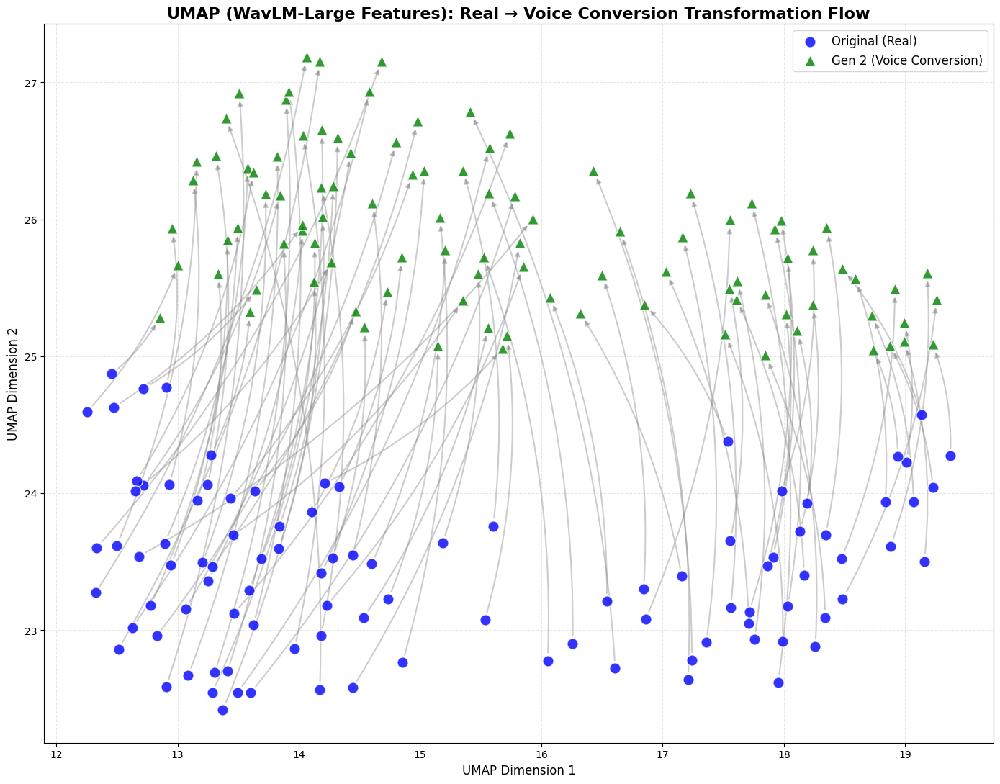


Visualization complete!
- Total pairs visualized: 100
- Feature dimension from WavLM-Large: 1024 (hidden_dim=1024)


In [31]:
# --- 4. UMAP 실행 ---

print("Running UMAP on WavLM-Large features...")

# 표준화
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# UMAP 적용 (WavLM hidden_dim=1024는 UMAP에 바로 적용 가능)
n_neighbors = min(15, len(X) - 1)
reducer = umap.UMAP(
    n_neighbors=n_neighbors,
    n_components=2,
    min_dist=0.3,
    metric='euclidean',
    random_state=42
)
X_embedded = reducer.fit_transform(X_scaled)

print(f"UMAP complete. Embedded shape: {X_embedded.shape}")

# --- 5. 시각화 (화살표 추가) ---

plt.figure(figsize=(14, 11))

# 5-1. 점 찍기 (산점도)
for idx, group_name in enumerate(target_groups):
    mask = (y == idx)
    plt.scatter(
        X_embedded[mask, 0], X_embedded[mask, 1],
        c=colors[idx], label=group_name, marker=markers[idx],
        s=120, alpha=0.8, edgecolors='white',
        zorder=2
    )

# 5-2. 화살표 그리기 (Original -> Gen 2)
print("Drawing arrows...")
unique_files = sorted(list(set(filenames)))

for base_name in unique_files:
    orig_indices = [i for i, (f, l) in enumerate(zip(filenames, labels)) if f == base_name and l == 0]
    gen2_indices = [i for i, (f, l) in enumerate(zip(filenames, labels)) if f == base_name and l == 1]

    if orig_indices and gen2_indices:
        start_pos = X_embedded[orig_indices[0]]
        end_pos = X_embedded[gen2_indices[0]]

        plt.annotate(
            "",
            xy=end_pos,
            xytext=start_pos,
            arrowprops=dict(
                arrowstyle="-|>",
                color='gray',
                alpha=0.4,
                linewidth=1.5,
                shrinkA=8, shrinkB=8,
                connectionstyle="arc3,rad=0.1"
            ),
            zorder=1
        )

# 5-3. 그래프 꾸미기
plt.title("UMAP (WavLM-Large Features): Real → Voice Conversion Transformation Flow", fontsize=16, fontweight='bold')
plt.xlabel("UMAP Dimension 1", fontsize=12)
plt.ylabel("UMAP Dimension 2", fontsize=12)
plt.legend(fontsize=12, loc='upper right')
plt.grid(True, linestyle='--', alpha=0.3)

plt.tight_layout()
plt.show()

print(f"\nVisualization complete!")
print(f"- Total pairs visualized: {len(unique_files)}")
print(f"- Feature dimension from WavLM-Large: {X.shape[1]} (hidden_dim=1024)")


Extracting features for UMAP...


Data shape: (200, 20480)
Running UMAP...


/mnt/fr20tb/jihwan/.conda/envs/deepfake_speech/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


Drawing arrows...


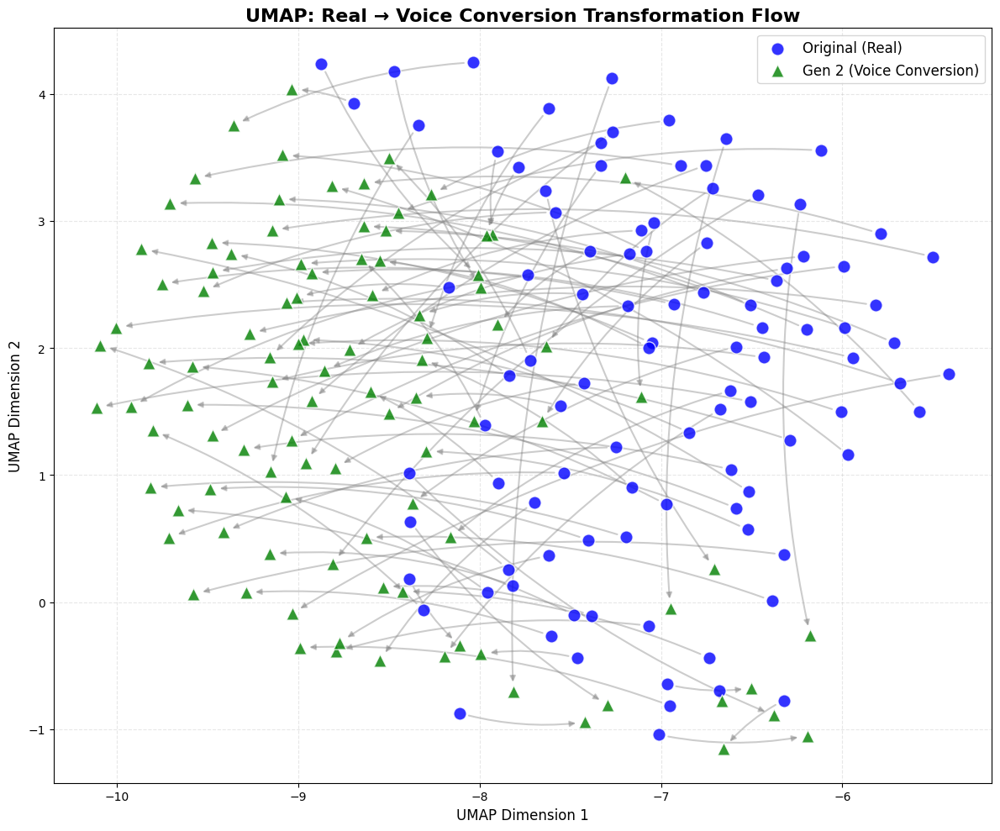

In [ ]:
import matplotlib.pyplot as plt
import torchaudio
import torch
import numpy as np
from pathlib import Path
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import umap

# --- 1. 설정 및 헬퍼 함수 (기존과 동일) ---

TARGET_WIDTH = 256

def resize_spectrogram(spec_tensor, target_width=TARGET_WIDTH):
    n_mels, width = spec_tensor.shape
    if width > target_width:
        start = (width - target_width) // 2
        return spec_tensor[:, start:start+target_width]
    elif width < target_width:
        pad_width = target_width - width
        return torch.nn.functional.pad(spec_tensor, (0, pad_width, 0, 0))
    return spec_tensor

def compute_mel_and_flatten_grad(audio_path, n_mels=80):
    try:
        waveform, sr = torchaudio.load(audio_path)
        mel = torchaudio.transforms.MelSpectrogram(
            sample_rate=sr, n_fft=1024, hop_length=256, n_mels=n_mels, normalized=True
        )(waveform)
        mel_db = torchaudio.functional.amplitude_to_DB(mel, multiplier=10.0, amin=1e-10, db_multiplier=1.0)
        mel_resized = resize_spectrogram(mel_db.squeeze(0))
        mel_np = mel_resized.numpy()
        grad_y, grad_x = np.gradient(mel_np)
        grad_mag = np.sqrt(grad_x**2 + grad_y**2)
        return grad_mag.flatten()
    except Exception as e:
        return None

# --- 2. 데이터 수집 (Original vs Gen 2) ---

features = []
labels = []
filenames = []

target_groups = ["Original (Real)", "Gen 2 (Voice Conversion)"]
label_map = {name: i for i, name in enumerate(target_groups)}
colors = ['blue', 'green']
markers = ['o', '^']

print("Extracting features for UMAP...")
for i, row in enumerate(dataframe_1000.to_dict('records')):
    base_name = Path(row['audio_path']).stem
    speaker_id = row['speaker_id']
    file_paths = {
        "Original (Real)": Path(row['audio_path']).resolve(),
        "Gen 2 (Voice Conversion)": Path(f"generated_results_F5_Fixed/gen_{i:03d}_{speaker_id}.wav")
    }
    for group_name, path in file_paths.items():
        if not path.exists(): continue
        vec = compute_mel_and_flatten_grad(str(path))
        if vec is not None:
            features.append(vec)
            labels.append(label_map[group_name])
            filenames.append(base_name)

X = np.array(features)
y = np.array(labels)
print(f"Data shape: {X.shape}")

# --- 3. UMAP 실행 ---

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# 고차원 데이터를 PCA로 먼저 압축하여 UMAP 속도 향상
n_components_pca = min(50, len(X), X.shape[1])
pca = PCA(n_components=n_components_pca)
X_pca = pca.fit_transform(X_scaled)

# UMAP 적용
print("Running UMAP...")
n_neighbors = min(15, len(X) - 1)
reducer = umap.UMAP(
    n_neighbors=n_neighbors,
    n_components=2,
    min_dist=0.3,
    metric='euclidean',
    random_state=42
)
X_embedded = reducer.fit_transform(X_pca)

# --- 4. 시각화 (화살표 추가) ---

plt.figure(figsize=(12, 10))

# 4-1. 점 찍기 (산점도)
for idx, group_name in enumerate(target_groups):
    mask = (y == idx)
    plt.scatter(
        X_embedded[mask, 0], X_embedded[mask, 1],
        c=colors[idx], label=group_name, marker=markers[idx],
        s=120, alpha=0.8, edgecolors='white',
        zorder=2
    )

# 4-2. 화살표 그리기 (Original -> Gen 2)
print("Drawing arrows...")
unique_files = sorted(list(set(filenames)))

for base_name in unique_files:
    orig_indices = [i for i, (f, l) in enumerate(zip(filenames, labels)) if f == base_name and l == 0]
    gen2_indices = [i for i, (f, l) in enumerate(zip(filenames, labels)) if f == base_name and l == 1]

    if orig_indices and gen2_indices:
        start_pos = X_embedded[orig_indices[0]]
        end_pos = X_embedded[gen2_indices[0]]

        plt.annotate(
            "",
            xy=end_pos,
            xytext=start_pos,
            arrowprops=dict(
                arrowstyle="-|>",
                color='gray',
                alpha=0.4,
                linewidth=1.5,
                shrinkA=8, shrinkB=8,
                connectionstyle="arc3,rad=0.1"
            ),
            zorder=1
        )

# 4-3. 그래프 꾸미기
plt.title("UMAP: Real → Voice Conversion Transformation Flow", fontsize=16, fontweight='bold')
plt.xlabel("UMAP Dimension 1", fontsize=12)
plt.ylabel("UMAP Dimension 2", fontsize=12)
plt.legend(fontsize=12, loc='upper right')
plt.grid(True, linestyle='--', alpha=0.3)

plt.tight_layout()
plt.show()

Extracting features for UMAP...


Data shape: (200, 20480)
Running UMAP with min_dist=0.2...


/mnt/fr20tb/jihwan/.conda/envs/deepfake_speech/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


Running UMAP with min_dist=0.3...


/mnt/fr20tb/jihwan/.conda/envs/deepfake_speech/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


Running UMAP with min_dist=0.4...


/mnt/fr20tb/jihwan/.conda/envs/deepfake_speech/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


Running UMAP with min_dist=0.5...


/mnt/fr20tb/jihwan/.conda/envs/deepfake_speech/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


Running UMAP with min_dist=0.6...


/mnt/fr20tb/jihwan/.conda/envs/deepfake_speech/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


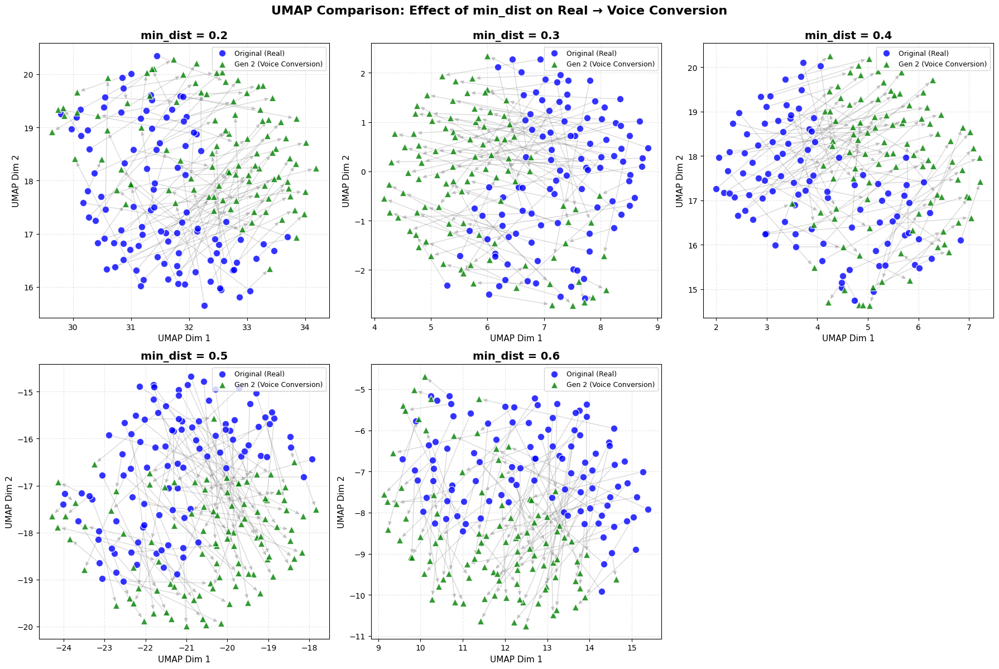

Visualization complete!


In [ ]:
import matplotlib.pyplot as plt
import torchaudio
import torch
import numpy as np
from pathlib import Path
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import umap

# --- 1. 설정 및 헬퍼 함수 (기존과 동일) ---

TARGET_WIDTH = 256

def resize_spectrogram(spec_tensor, target_width=TARGET_WIDTH):
    n_mels, width = spec_tensor.shape
    if width > target_width:
        start = (width - target_width) // 2
        return spec_tensor[:, start:start+target_width]
    elif width < target_width:
        pad_width = target_width - width
        return torch.nn.functional.pad(spec_tensor, (0, pad_width, 0, 0))
    return spec_tensor

def compute_mel_and_flatten_grad(audio_path, n_mels=80):
    try:
        waveform, sr = torchaudio.load(audio_path)
        mel = torchaudio.transforms.MelSpectrogram(
            sample_rate=sr, n_fft=1024, hop_length=256, n_mels=n_mels, normalized=True
        )(waveform)
        mel_db = torchaudio.functional.amplitude_to_DB(mel, multiplier=10.0, amin=1e-10, db_multiplier=1.0)
        mel_resized = resize_spectrogram(mel_db.squeeze(0))
        mel_np = mel_resized.numpy()
        grad_y, grad_x = np.gradient(mel_np)
        grad_mag = np.sqrt(grad_x**2 + grad_y**2)
        return grad_mag.flatten()
    except Exception as e:
        return None

# --- 2. 데이터 수집 (Original vs Gen 2) ---

features = []
labels = []
filenames = []

target_groups = ["Original (Real)", "Gen 2 (Voice Conversion)"]
label_map = {name: i for i, name in enumerate(target_groups)}
colors = ['blue', 'green']
markers = ['o', '^']

print("Extracting features for UMAP...")
for i, row in enumerate(dataframe_1000.to_dict('records')):
    base_name = Path(row['audio_path']).stem
    speaker_id = row['speaker_id']
    file_paths = {
        "Original (Real)": Path(row['audio_path']).resolve(),
        "Gen 2 (Voice Conversion)": Path(f"generated_results_F5_Fixed/gen_{i:03d}_{speaker_id}.wav")
    }
    for group_name, path in file_paths.items():
        if not path.exists(): continue
        vec = compute_mel_and_flatten_grad(str(path))
        if vec is not None:
            features.append(vec)
            labels.append(label_map[group_name])
            filenames.append(base_name)

X = np.array(features)
y = np.array(labels)
print(f"Data shape: {X.shape}")

# --- 3. 전처리 (스케일링 및 PCA) ---

scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# 고차원 데이터를 PCA로 먼저 압축하여 UMAP 속도 향상
n_components_pca = min(50, len(X), X.shape[1])
pca = PCA(n_components=n_components_pca)
X_pca = pca.fit_transform(X_scaled)

# --- 4. 여러 min_dist 값으로 UMAP 실행 및 비교 시각화 ---

min_dist_values = [0.2, 0.3, 0.4, 0.5, 0.6]
n_neighbors = min(15, len(X) - 1)

fig, axes = plt.subplots(2, 3, figsize=(18, 12))
axes = axes.flatten()

for idx, min_dist_val in enumerate(min_dist_values):
    print(f"Running UMAP with min_dist={min_dist_val}...")
    
    reducer = umap.UMAP(
        n_neighbors=n_neighbors,
        n_components=2,
        min_dist=min_dist_val,
        metric='euclidean',
        random_state=42
    )
    X_embedded = reducer.fit_transform(X_pca)
    
    ax = axes[idx]
    
    # 점 찍기 (산점도)
    for group_idx, group_name in enumerate(target_groups):
        mask = (y == group_idx)
        ax.scatter(
            X_embedded[mask, 0], X_embedded[mask, 1],
            c=colors[group_idx], label=group_name, marker=markers[group_idx],
            s=80, alpha=0.8, edgecolors='white',
            zorder=2
        )
    
    # 화살표 그리기 (Original -> Gen 2)
    unique_files = sorted(list(set(filenames)))
    
    for base_name in unique_files:
        orig_indices = [i for i, (f, l) in enumerate(zip(filenames, labels)) if f == base_name and l == 0]
        gen2_indices = [i for i, (f, l) in enumerate(zip(filenames, labels)) if f == base_name and l == 1]
        
        if orig_indices and gen2_indices:
            start_pos = X_embedded[orig_indices[0]]
            end_pos = X_embedded[gen2_indices[0]]
            
            ax.annotate(
                "",
                xy=end_pos,
                xytext=start_pos,
                arrowprops=dict(
                    arrowstyle="-|>",
                    color='gray',
                    alpha=0.3,
                    linewidth=1.0,
                    shrinkA=5, shrinkB=5
                ),
                zorder=1
            )
    
    # 서브플롯 꾸미기
    ax.set_title(f"min_dist = {min_dist_val}", fontsize=14, fontweight='bold')
    ax.set_xlabel("UMAP Dim 1", fontsize=11)
    ax.set_ylabel("UMAP Dim 2", fontsize=11)
    ax.legend(fontsize=9, loc='upper right')
    ax.grid(True, linestyle='--', alpha=0.3)

# 빈 서브플롯 숨기기
axes[-1].axis('off')

fig.suptitle("UMAP Comparison: Effect of min_dist on Real → Voice Conversion", 
             fontsize=16, fontweight='bold', y=0.995)
plt.tight_layout()
plt.show()

print("Visualization complete!")

### Whisper Encoder Latent UMAP Analysis

In [43]:
dataframe_1000.head()

,speaker_id,chapter_id,utterance_id,transcript,audio_path
0,1089,134686,1089-134686-0000,HE HOPED THERE WOULD BE STEW FOR DINNER TURNIP...,my_librispeech/LibriSpeech/test-clean/1089/134...
1,1089,134686,1089-134686-0001,STUFF IT INTO YOU HIS BELLY COUNSELLED HIM,my_librispeech/LibriSpeech/test-clean/1089/134...
2,1089,134686,1089-134686-0002,AFTER EARLY NIGHTFALL THE YELLOW LAMPS WOULD L...,my_librispeech/LibriSpeech/test-clean/1089/134...
3,1089,134686,1089-134686-0003,HELLO BERTIE ANY GOOD IN YOUR MIND,my_librispeech/LibriSpeech/test-clean/1089/134...
4,1089,134686,1089-134686-0004,NUMBER TEN FRESH NELLY IS WAITING ON YOU GOOD ...,my_librispeech/LibriSpeech/test-clean/1089/134...


In [44]:
import matplotlib.pyplot as plt
import torch
import numpy as np
from pathlib import Path
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import umap
import librosa
from transformers import WhisperProcessor, WhisperModel

# --- 1. Whisper 모델 로드 (Hugging Face transformers 사용) ---
print("Loading Whisper model from Hugging Face...")
device = "cuda" if torch.cuda.is_available() else "cpu"
model_name = "openai/whisper-base"

processor = WhisperProcessor.from_pretrained(model_name)
model = WhisperModel.from_pretrained(model_name).to(device)
model.eval()

print(f"Whisper model loaded on {device}")

# --- 2. Whisper Encoder Latent 추출 함수 ---

def extract_whisper_encoder_features(audio_path, model, processor, device):
    """
    Whisper encoder를 통과한 latent representation을 추출합니다.
    
    Args:
        audio_path: 오디오 파일 경로
        model: Whisper 모델
        processor: Whisper 프로세서
        device: 'cuda' 또는 'cpu'
    
    Returns:
        평균 풀링된 encoder output (numpy array)
    """
    try:
        # 1. 오디오 로드 (librosa 사용, Whisper는 16kHz 필요)
        audio, sr = librosa.load(str(audio_path), sr=16000, mono=True)
        
        # 최대 30초로 제한 (Whisper의 최대 입력 길이)
        max_length = 30 * 16000
        if len(audio) > max_length:
            audio = audio[:max_length]
        
        # 2. 오디오를 Whisper 입력 형식으로 변환
        input_features = processor(
            audio, 
            sampling_rate=16000, 
            return_tensors="pt"
        ).input_features.to(device)
        
        # 3. Encoder forward pass
        with torch.no_grad():
            encoder_output = model.encoder(input_features)
            # encoder_output.last_hidden_state: (batch, seq_len, hidden_dim)
        
        # 4. 시퀀스 차원에 대해 평균 풀링
        pooled_features = encoder_output.last_hidden_state.mean(dim=1).squeeze(0).cpu().numpy()
        
        return pooled_features
    
    except Exception as e:
        print(f"Error extracting features from {audio_path}: {e}")
        return None

# --- 3. 데이터 수집 (Original vs Gen 2) ---

features = []
labels = []
filenames = []

target_groups = ["Original (Real)", "Gen 2 (Voice Conversion)"]
label_map = {name: i for i, name in enumerate(target_groups)}
colors = ['blue', 'green']
markers = ['o', '^']

print("Extracting Whisper encoder features...")
for i, row in enumerate(dataframe_1000.to_dict('records')):
    base_name = Path(row['audio_path']).stem
    speaker_id = row['speaker_id']
    
    file_paths = {
        "Original (Real)": Path(row['audio_path']).resolve(),
        "Gen 2 (Voice Conversion)": Path(f"generated_results_F5_Fixed/gen_{i:03d}_{speaker_id}.wav")
    }
    
    for group_name, path in file_paths.items():
        if not path.exists(): 
            continue
            
        vec = extract_whisper_encoder_features(path, model, processor, device)
        
        if vec is not None:
            features.append(vec)
            labels.append(label_map[group_name])
            filenames.append(base_name)
    
    # 진행 상황 표시
    if (i + 1) % 100 == 0:
        print(f"Processed {i + 1} / {len(dataframe_1000)} samples...")

X = np.array(features)
y = np.array(labels)
print(f"\nFeature extraction complete. Data shape: {X.shape}")
print(f"Total samples: {len(X)}, Feature dimension: {X.shape[1]}")

Loading Whisper model from Hugging Face...
Whisper model loaded on cuda
Extracting Whisper encoder features...
Processed 100 / 100 samples...

Feature extraction complete. Data shape: (200, 512)
Total samples: 200, Feature dimension: 512


Running UMAP on Whisper features...


/mnt/fr20tb/jihwan/.conda/envs/deepfake_speech/lib/python3.12/site-packages/umap/umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


UMAP complete. Embedded shape: (200, 2)
Drawing arrows...


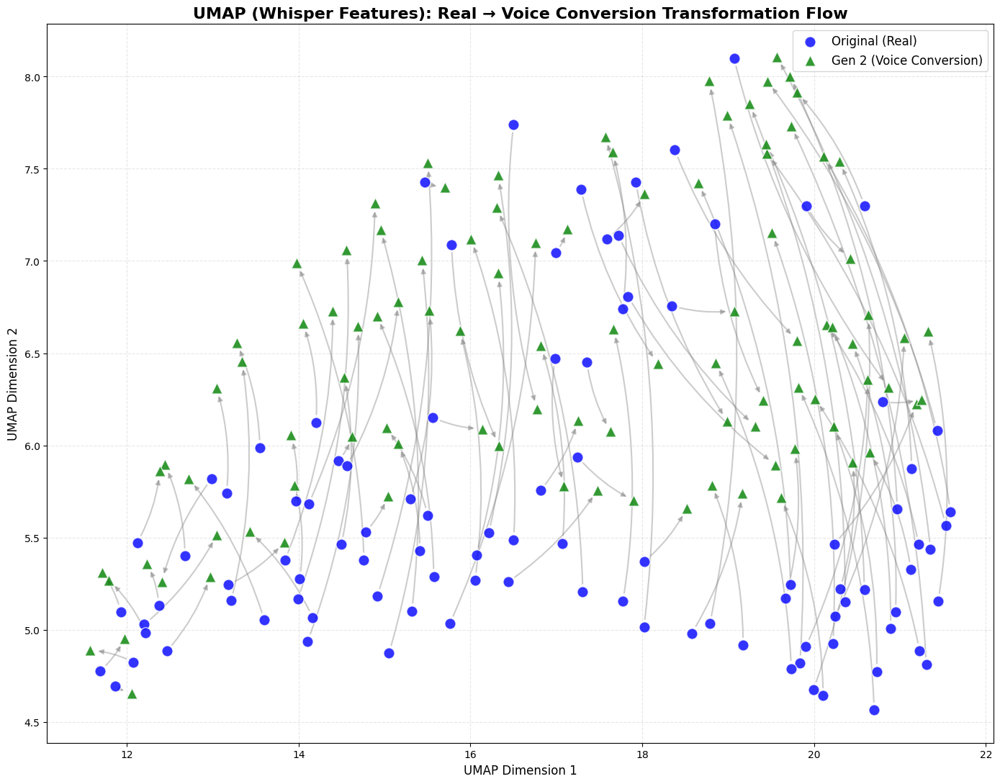


Visualization complete!
- Total pairs visualized: 100
- Feature dimension from Whisper: 512


In [45]:
# whisper UMAP 시각화 
import matplotlib.pyplot as plt
import torch
import numpy as np
from pathlib import Path
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

# --- Whisper UMAP 시각화 ---

print("Running UMAP on Whisper features...")

# 표준화
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# UMAP 적용
n_neighbors = min(15, len(X) - 1)
reducer = umap.UMAP(
    n_neighbors=n_neighbors,
    n_components=2,
    min_dist=0.3,
    metric='euclidean',
    random_state=42
)
X_embedded = reducer.fit_transform(X_scaled)

print(f"UMAP complete. Embedded shape: {X_embedded.shape}")

# 시각화 (화살표 추가)
plt.figure(figsize=(14, 11))

# 점 찍기 (산점도)
for idx, group_name in enumerate(target_groups):
    mask = (y == idx)
    plt.scatter(
        X_embedded[mask, 0], X_embedded[mask, 1],
        c=colors[idx], label=group_name, marker=markers[idx],
        s=120, alpha=0.8, edgecolors='white',
        zorder=2
    )

# 화살표 그리기 (Original -> Gen 2)
print("Drawing arrows...")
unique_files = sorted(list(set(filenames)))

for base_name in unique_files:
    orig_indices = [i for i, (f, l) in enumerate(zip(filenames, labels)) if f == base_name and l == 0]
    gen2_indices = [i for i, (f, l) in enumerate(zip(filenames, labels)) if f == base_name and l == 1]

    if orig_indices and gen2_indices:
        start_pos = X_embedded[orig_indices[0]]
        end_pos = X_embedded[gen2_indices[0]]

        plt.annotate(
            "",
            xy=end_pos,
            xytext=start_pos,
            arrowprops=dict(
                arrowstyle="-|>",
                color='gray',
                alpha=0.4,
                linewidth=1.5,
                shrinkA=8, shrinkB=8,
                connectionstyle="arc3,rad=0.1"
            ),
            zorder=1
        )

# 그래프 꾸미기
plt.title("UMAP (Whisper Features): Real → Voice Conversion Transformation Flow", fontsize=16, fontweight='bold')
plt.xlabel("UMAP Dimension 1", fontsize=12)
plt.ylabel("UMAP Dimension 2", fontsize=12)
plt.legend(fontsize=12, loc='upper right')
plt.grid(True, linestyle='--', alpha=0.3)

plt.tight_layout()
plt.show()

print(f"\nVisualization complete!")
print(f"- Total pairs visualized: {len(unique_files)}")
print(f"- Feature dimension from Whisper: {X.shape[1]}")